In [1]:
from tensorflow.keras.applications.imagenet_utils import preprocess_input
from tensorflow.keras.applications.resnet50 import decode_predictions
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import json
import cv2
import random
import sys
import os

# Get the absolute path of the src folder
sys.path.append(os.path.abspath("src"))


from utils import show_image, preprocess_image, clip_eps, get_label
from whitebox import generate_adversaries_targeted, perturb_image, verify_watermark, collect_logits

2025-03-02 17:11:22.804926: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-03-02 17:11:22.804946: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-03-02 17:11:22.806022: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-03-02 17:11:22.811780: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
# uncomment below to download the dataset and install the dependencies
# import os
# import shutil
# import kagglehub

# # Define dataset name
# dataset_name = "titericz/imagenet1k-val"

# # Automatically determine the KaggleHub cache directory
# cache_dir = os.path.expanduser("~/.cache/kagglehub/datasets")
# dataset_path = os.path.join(cache_dir, dataset_name, "versions/1")

# # Define destination folder in the current working directory
# destination = os.path.abspath("imagenet1k-val")

# # Download dataset (KaggleHub saves it in its cache location)
# path = kagglehub.dataset_download(dataset_name)

# # Ensure the dataset path exists and is not empty
# if os.path.exists(dataset_path) and os.listdir(dataset_path):
#     # Copy dataset instead of moving to prevent empty folder issues
#     shutil.copytree(dataset_path, destination, dirs_exist_ok=True)

#     print(f"Dataset successfully copied to: {destination}")

#     # Optional: Delete original cache to save space
#     shutil.rmtree(dataset_path)
#     print(f"Deleted cache folder: {dataset_path}")
# else:
#     print("Error: Dataset path not found or dataset is empty!")

# print(f"Path to dataset files: {destination}")


In [3]:
#pip install -r requirements.txt

In [4]:
EPS = 2./255
IMAGENET_LABELS = "./data/imagenet_class_index.json"

with open(IMAGENET_LABELS) as f:
    IMAGENET_CLASSES = {int(i):x[1] for i,x in json.load(f).items()}

In [6]:
k = 4
secret_labels = random.sample(range(1000), k)
print("Secret labels:", secret_labels)
print("Secret label names:", [IMAGENET_CLASSES[label] for label in secret_labels])

Secret labels: [818, 780, 527, 769]
Secret label names: ['spotlight', 'schooner', 'desktop_computer', 'rule']


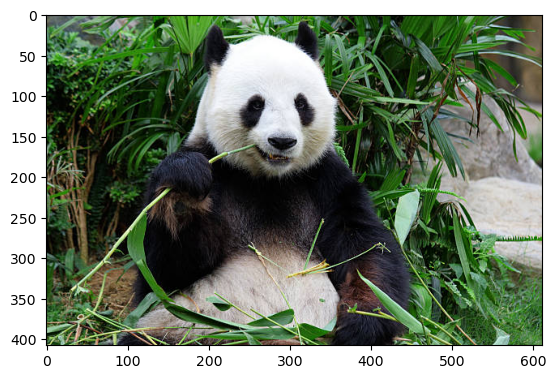

2025-03-02 16:37:27.070689: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2025-03-02 16:37:27.077676: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2025-03-02 16:37:27.078067: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

In [7]:
sample_image = show_image("./data/imagenet/giant_panda/giantpanda.jpg")
preprocessed_image = preprocess_image(sample_image, preprocess=True)
resnet50 = tf.keras.applications.ResNet50(weights="imagenet", include_top=True, classifier_activation=None)

In [8]:
preds = resnet50.predict(preprocessed_image)
print("Logits:", decode_predictions(preds, top=3)[0])
print("Class idx:", preds.argmax())


2025-03-02 16:37:31.062319: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8902


1/1 [==============================] - 2s 2s/step
Logits: [('n02510455', 'giant_panda', 17.557981), ('n02509815', 'lesser_panda', 10.098653), ('n02488702', 'colobus', 9.425187)]
Class idx: 388


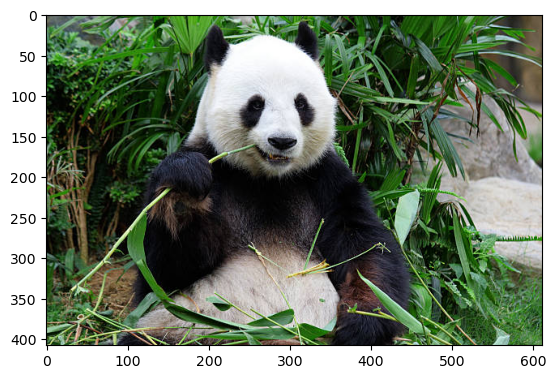

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 27ms/step
Logits before adv.: [('n02510455', 'giant_panda', 17.554651), ('n02509815', 'lesser_panda', 10.111225), ('n02488702', 'colobus', 9.48891)]
True label (max logit): giant_panda (Index: 388)

Predictions for secret labels BEFORE perturbation:
Label: spotlight (Index: 818), Logit: 0.2658855617046356
Label: schooner (Index: 780), Logit: -2.911153554916382
Label: desktop_computer (Index: 527), Logit: -1.2782604694366455
Label: rule (Index: 769), Logit: -0.6299702525138855
Iteration 0, Loss: 18.69573211669922
Iteration 20, Loss: 13.721476554870605
Iteration 40, Loss: 10.905388832092285
Iteration 60, Loss: 9.977890968322754
Iteration 80, Loss: 9.854216575622559
Iteration 100, Loss: 9.721752166748047
Iteration 120, Loss: 9.57451057434082
Iteration 140, Loss: 9.42564868927002
Iteration 160, Loss: 9.269674301147461
Iteration 180, Loss: 9.10543155670166
Iteration 200, Loss: 8.9373741149

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


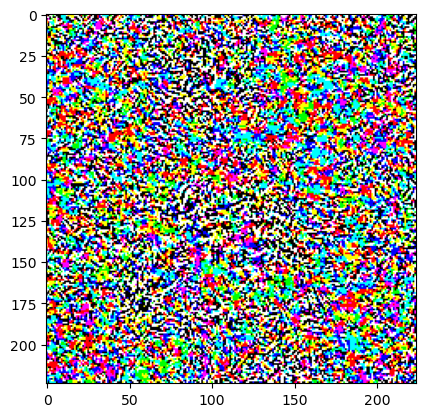

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Perturbed image saved at: ./output/perturbed_image.png


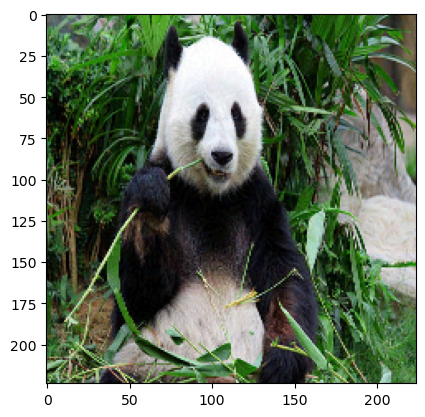

1/1 [==============================] - 0s 22ms/step
Logits after adv.: [('n02510455', 'giant_panda', 7.2457185), ('n02488702', 'colobus', 4.038849), ('n04254680', 'soccer_ball', 3.8581164)]

Predictions for secret labels:
Label: spotlight (Index: 818), Logit: 3.0117027759552
Label: schooner (Index: 780), Logit: -0.9895288944244385
Label: desktop_computer (Index: 527), Logit: 1.6579623222351074
Label: rule (Index: 769), Logit: 1.8888769149780273
Label: spotlight (818) | Logit Before: 0.26589 | Logit After: 3.01170 | Logit Diff: 2.74582
Label: schooner (780) | Logit Before: -2.91115 | Logit After: -0.98953 | Logit Diff: 1.92162
Label: desktop_computer (527) | Logit Before: -1.27826 | Logit After: 1.65796 | Logit Diff: 2.93622
Label: rule (769) | Logit Before: -0.62997 | Logit After: 1.88888 | Logit Diff: 2.51885
Average Difference: 2.530627965927124
Watermark verified!


({818: 0.26588556, 780: -2.9111536, 527: -1.2782605, 769: -0.62997025},
 {818: 3.0117028, 780: -0.9895289, 527: 1.6579623, 769: 1.8888769},
 array([[ 9.52851176e-01, -4.77921546e-01, -2.22404552e+00,
         -1.95905590e+00, -2.96483707e+00, -2.92303491e+00,
         -2.62825036e+00,  7.96989202e-01,  2.16014051e+00,
         -1.02968013e+00, -2.67891979e+00,  6.97129786e-01,
         -3.19512105e+00, -1.01462209e+00, -1.27846038e+00,
         -2.30978584e+00, -8.92601550e-01,  1.85023177e+00,
          2.33972025e+00,  7.08038986e-01, -1.46433783e+00,
          2.19433498e+00,  9.21835542e-01,  4.84690523e+00,
          2.05163765e+00,  1.11513339e-01, -2.22411776e+00,
         -2.16666675e+00, -1.84011805e+00, -4.28353757e-01,
         -2.36584616e+00, -5.37289798e-01, -1.60142016e+00,
         -4.23074543e-01, -1.35850406e+00, -1.51898205e+00,
          2.77559257e+00, -1.37630701e+00, -3.11110234e+00,
         -4.43384767e-01, -2.09873271e+00, -2.91587210e+00,
         -4.25557375

In [9]:
#@title Adam
optimizer = tf.keras.optimizers.legacy.Adam(learning_rate=5e-3)
perturb_image("./examples/panda.jpg", 388, secret_labels, resnet50, optimizer,EPS, 350)

## Generate Logits Graph ##

In [7]:
IMAGENET = "./data/imagenet_class_index.json"

with open(IMAGENET) as f:
    IMAGENET = {x[0]:x[1] for i,x in json.load(f).items()}



In [8]:
import random
from PIL import Image
def display_one_image_per_folder(root_folder, max_folders=10):
    """
    Display one image from each of `max_folders` randomly selected subfolders with the folder name as the title.

    Args:
        root_folder (str): Path to the folder containing subfolders with images.
        max_folders (int): Maximum number of folders to process.
    """
    # Get a list of all subfolders
    subfolders = [f.path for f in os.scandir(root_folder) if f.is_dir()]
    


    # Randomly select `max_folders` folders
    if len(subfolders) > max_folders:
        subfolders = random.sample(subfolders, max_folders)
    

    all_logits_before = {label: [] for label in secret_labels}
    all_logits_after = {label: [] for label in secret_labels}

    # Iterate through each subfolder
    for folder in subfolders:
        # Get the folder name (ID)
        folder_name = os.path.basename(folder)

        # Get a list of images in the folder
        images = [f for f in os.listdir(folder) if f.endswith(('.jpg', '.jpeg', '.png', '.JPEG'))]

        if images:
            first_image_path = os.path.join(folder, images[0])

            # Open and display the image
            img = show_image(first_image_path)
            preprocessed_image = preprocess_image(img, preprocess=True)

            preds = resnet50.predict(preprocessed_image)
            print("Logits:", decode_predictions(preds, top=3)[0])
            print("Class idx:", preds.argmax())

            true_label = preds.argmax()
            # Perturb the image and get logit scores
            logits_before, logits_after,logits_before_all,logits_after_all = perturb_image(first_image_path, true_label, secret_labels, resnet50, optimizer, EPS, 100)

            # Store logit scores
            for label in secret_labels:
                all_logits_before[label].append(logits_before[label])
                all_logits_after[label].append(logits_after[label])

        

        else:
            print(f"No images found in folder: {folder_name}")
    return all_logits_before, all_logits_after, logits_before_all,logits_after_all 



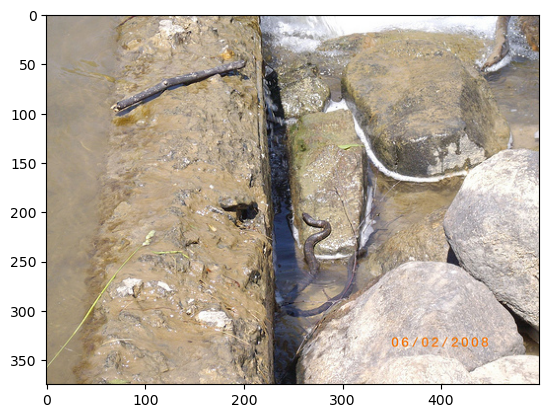

1/1 [==============================] - 0s 29ms/step
Logits: [('n01775062', 'wolf_spider', 8.42004), ('n04326547', 'stone_wall', 7.8369837), ('n03804744', 'nail', 6.926643)]
Class idx: 77


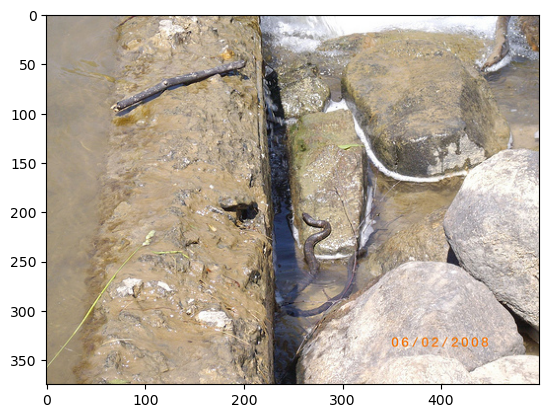

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 29ms/step
Logits before adv.: [('n01775062', 'wolf_spider', 8.434862), ('n04326547', 'stone_wall', 7.832452), ('n01774384', 'black_widow', 6.914546)]
True label (max logit): wolf_spider (Index: 77)

Predictions for secret labels BEFORE perturbation:
Label: library (Index: 624), Logit: -1.7279239892959595
Label: basenji (Index: 253), Logit: -2.369313955307007
Label: scale (Index: 778), Logit: 2.0443670749664307
Label: snowplow (Index: 803), Logit: -2.0952696800231934
Iteration 0, Loss: 12.520889282226562
Iteration 20, Loss: 9.047264099121094
Iteration 40, Loss: 6.979031562805176
Iteration 60, Loss: 5.453069686889648
Iteration 80, Loss: 4.484468936920166


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


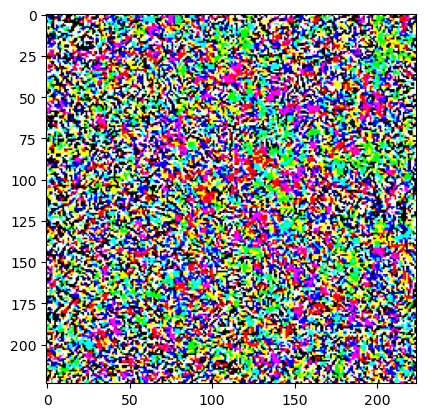

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


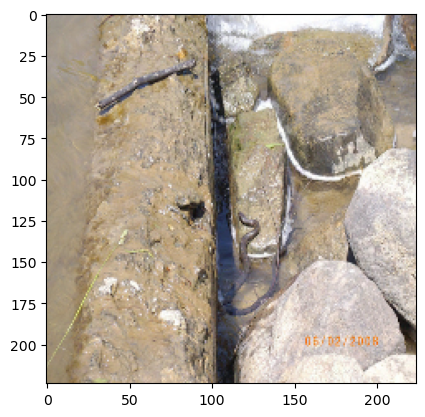

1/1 [==============================] - 0s 26ms/step
Logits after adv.: [('n01775062', 'wolf_spider', 9.730038), ('n04141975', 'scale', 8.304341), ('n02110806', 'basenji', 8.188623)]

Predictions for secret labels:
Label: library (Index: 624), Logit: 4.7456841468811035
Label: basenji (Index: 253), Logit: 8.188623428344727
Label: scale (Index: 778), Logit: 8.304341316223145
Label: snowplow (Index: 803), Logit: 7.94476318359375
Label: library (624) | Logit Before: -1.72792 | Logit After: 4.74568 | Logit Diff: 6.47361
Label: basenji (253) | Logit Before: -2.36931 | Logit After: 8.18862 | Logit Diff: 10.55794
Label: scale (778) | Logit Before: 2.04437 | Logit After: 8.30434 | Logit Diff: 6.25997
Label: snowplow (803) | Logit Before: -2.09527 | Logit After: 7.94476 | Logit Diff: 10.04003
Average Difference: 8.33288836479187
Watermark verified!


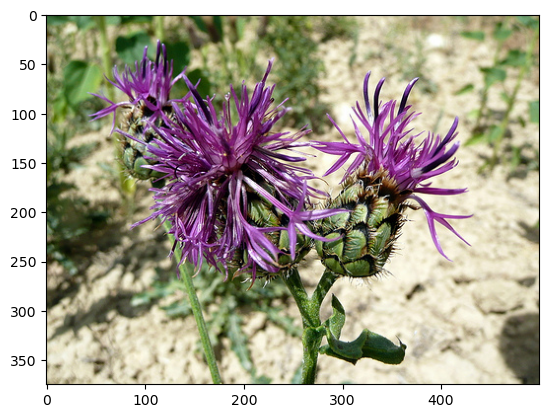

1/1 [==============================] - 0s 26ms/step
Logits: [('n07730033', 'cardoon', 20.668266), ('n07718747', 'artichoke', 16.143467), ('n02206856', 'bee', 15.294564)]
Class idx: 946


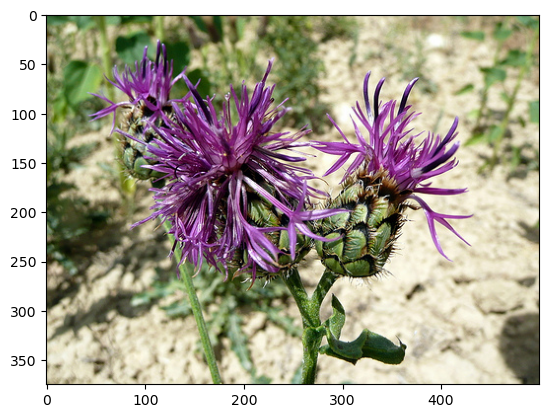

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 26ms/step
Logits before adv.: [('n07730033', 'cardoon', 20.69982), ('n07718747', 'artichoke', 16.167305), ('n02206856', 'bee', 15.284671)]
True label (max logit): cardoon (Index: 946)

Predictions for secret labels BEFORE perturbation:
Label: library (Index: 624), Logit: -1.6412146091461182
Label: basenji (Index: 253), Logit: -0.7365342974662781
Label: scale (Index: 778), Logit: -1.2252506017684937
Label: snowplow (Index: 803), Logit: -2.836153030395508
Iteration 0, Loss: 22.341875076293945
Iteration 20, Loss: 13.860404968261719
Iteration 40, Loss: 10.910283088684082
Iteration 60, Loss: 10.110730171203613
Iteration 80, Loss: 9.655835151672363


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


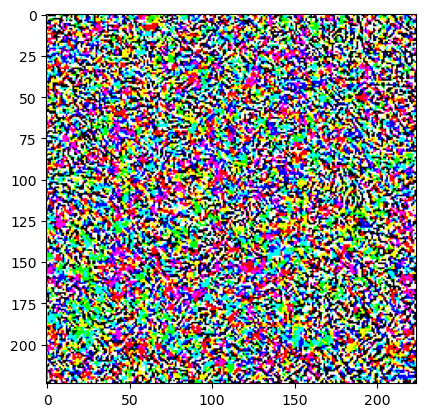

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


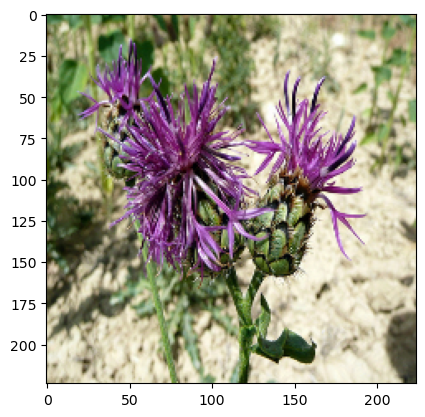

1/1 [==============================] - 0s 27ms/step
Logits after adv.: [('n07730033', 'cardoon', 7.6197953), ('n02280649', 'cabbage_butterfly', 5.475987), ('n02206856', 'bee', 5.1056733)]

Predictions for secret labels:
Label: library (Index: 624), Logit: -0.33936262130737305
Label: basenji (Index: 253), Logit: 0.25661206245422363
Label: scale (Index: 778), Logit: 1.4081140756607056
Label: snowplow (Index: 803), Logit: -0.13630734384059906
Label: library (624) | Logit Before: -1.64121 | Logit After: -0.33936 | Logit Diff: 1.30185
Label: basenji (253) | Logit Before: -0.73653 | Logit After: 0.25661 | Logit Diff: 0.99315
Label: scale (778) | Logit Before: -1.22525 | Logit After: 1.40811 | Logit Diff: 2.63336
Label: snowplow (803) | Logit Before: -2.83615 | Logit After: -0.13631 | Logit Diff: 2.69985
Average Difference: 1.9070522040128708
Watermark verified!


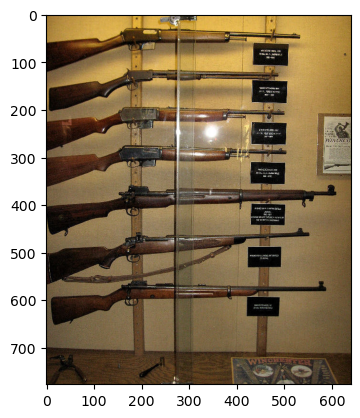

1/1 [==============================] - 0s 26ms/step
Logits: [('n04090263', 'rifle', 22.080126), ('n02749479', 'assault_rifle', 15.563389), ('n02879718', 'bow', 13.367433)]
Class idx: 764


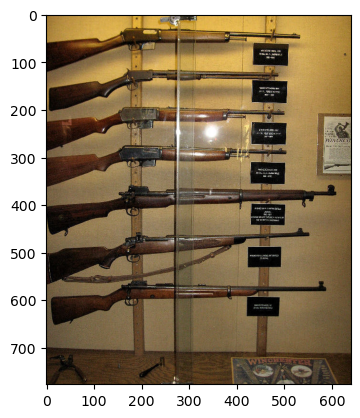

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 28ms/step
Logits before adv.: [('n04090263', 'rifle', 22.086178), ('n02749479', 'assault_rifle', 15.582896), ('n02879718', 'bow', 13.373627)]
True label (max logit): rifle (Index: 764)

Predictions for secret labels BEFORE perturbation:
Label: library (Index: 624), Logit: 5.3935723304748535
Label: basenji (Index: 253), Logit: -3.1016523838043213
Label: scale (Index: 778), Logit: 4.458912372589111
Label: snowplow (Index: 803), Logit: -4.967918395996094
Iteration 0, Loss: 21.644851684570312
Iteration 20, Loss: 11.028217315673828
Iteration 40, Loss: 9.601829528808594
Iteration 60, Loss: 8.86492919921875
Iteration 80, Loss: 8.374276161193848


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


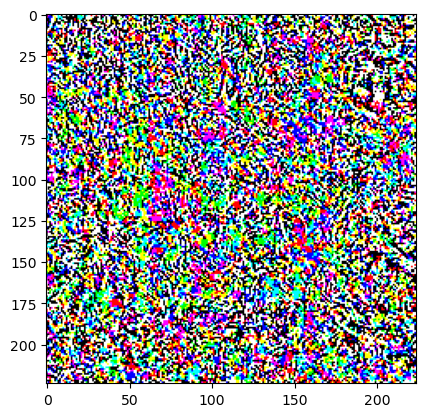

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


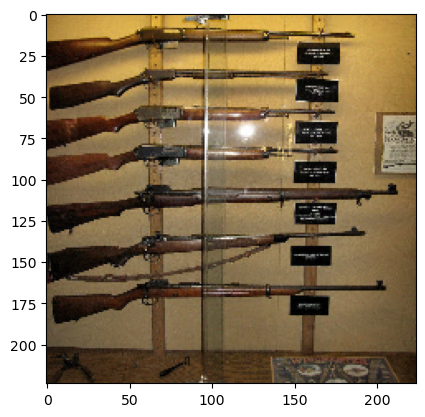

1/1 [==============================] - 0s 28ms/step
Logits after adv.: [('n04090263', 'rifle', 9.094347), ('n04141975', 'scale', 7.158743), ('n02892201', 'brass', 6.4814854)]

Predictions for secret labels:
Label: library (Index: 624), Logit: 6.092815399169922
Label: basenji (Index: 253), Logit: -0.599686861038208
Label: scale (Index: 778), Logit: 7.158742904663086
Label: snowplow (Index: 803), Logit: -1.1680561304092407
Label: library (624) | Logit Before: 5.39357 | Logit After: 6.09282 | Logit Diff: 0.69924
Label: basenji (253) | Logit Before: -3.10165 | Logit After: -0.59969 | Logit Diff: 2.50197
Label: scale (778) | Logit Before: 4.45891 | Logit After: 7.15874 | Logit Diff: 2.69983
Label: snowplow (803) | Logit Before: -4.96792 | Logit After: -1.16806 | Logit Diff: 3.79986
Average Difference: 2.4252253770828247
Watermark verified!


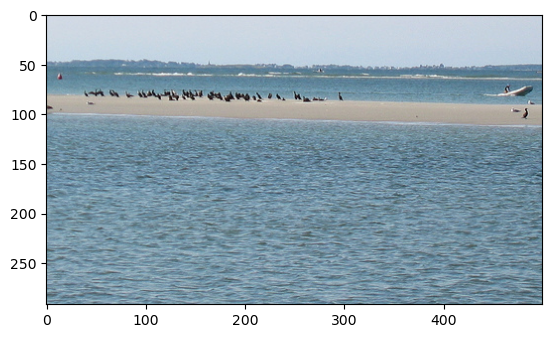

1/1 [==============================] - 0s 28ms/step
Logits: [('n09421951', 'sandbar', 19.599241), ('n02894605', 'breakwater', 11.409225), ('n09332890', 'lakeside', 11.147192)]
Class idx: 977


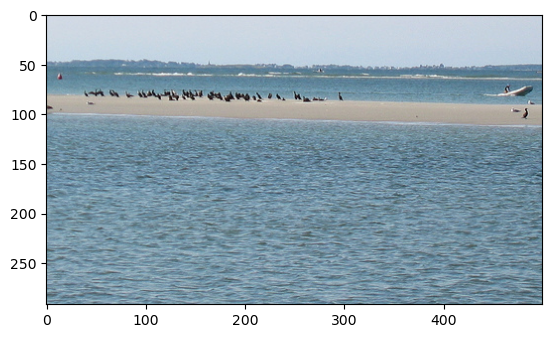

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 27ms/step
Logits before adv.: [('n09421951', 'sandbar', 19.650843), ('n02894605', 'breakwater', 11.404219), ('n09332890', 'lakeside', 11.1679535)]
True label (max logit): sandbar (Index: 977)

Predictions for secret labels BEFORE perturbation:
Label: library (Index: 624), Logit: -2.153059720993042
Label: basenji (Index: 253), Logit: -1.3705477714538574
Label: scale (Index: 778), Logit: -1.9217455387115479
Label: snowplow (Index: 803), Logit: -0.09343551099300385
Iteration 0, Loss: 21.036645889282227
Iteration 20, Loss: 11.15666389465332
Iteration 40, Loss: 9.148983001708984
Iteration 60, Loss: 7.931687355041504
Iteration 80, Loss: 7.104398727416992


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


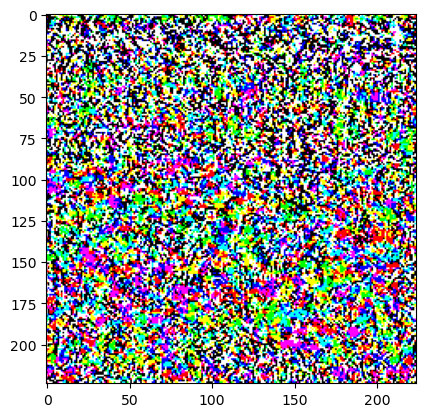

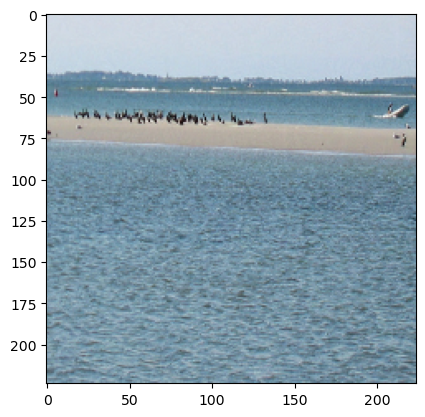

1/1 [==============================] - 0s 30ms/step
Logits after adv.: [('n09421951', 'sandbar', 8.428146), ('n04252225', 'snowplow', 6.6208496), ('n02134084', 'ice_bear', 5.1180944)]

Predictions for secret labels:
Label: library (Index: 624), Logit: 1.7759195566177368
Label: basenji (Index: 253), Logit: 1.7280497550964355
Label: scale (Index: 778), Logit: 4.683047771453857
Label: snowplow (Index: 803), Logit: 6.620849609375
Label: library (624) | Logit Before: -2.15306 | Logit After: 1.77592 | Logit Diff: 3.92898
Label: basenji (253) | Logit Before: -1.37055 | Logit After: 1.72805 | Logit Diff: 3.09860
Label: scale (778) | Logit Before: -1.92175 | Logit After: 4.68305 | Logit Diff: 6.60479
Label: snowplow (803) | Logit Before: -0.09344 | Logit After: 6.62085 | Logit Diff: 6.71428
Average Difference: 5.086663842201233
Watermark verified!


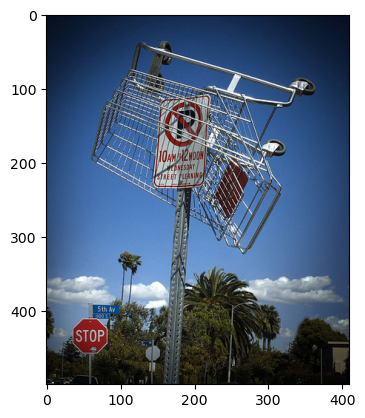

1/1 [==============================] - 0s 27ms/step
Logits: [('n04204347', 'shopping_cart', 20.544191), ('n04127249', 'safety_pin', 11.52826), ('n04204238', 'shopping_basket', 10.236747)]
Class idx: 791


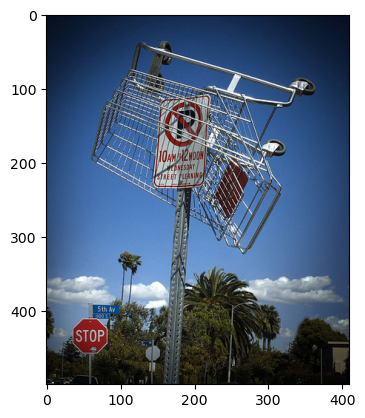

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 26ms/step
Logits before adv.: [('n04204347', 'shopping_cart', 20.568956), ('n04127249', 'safety_pin', 11.600098), ('n04204238', 'shopping_basket', 10.262517)]
True label (max logit): shopping_cart (Index: 791)

Predictions for secret labels BEFORE perturbation:
Label: library (Index: 624), Logit: 1.523997187614441
Label: basenji (Index: 253), Logit: 0.5551270842552185
Label: scale (Index: 778), Logit: 4.713066101074219
Label: snowplow (Index: 803), Logit: -2.364163875579834
Iteration 0, Loss: 19.461088180541992
Iteration 20, Loss: 9.928888320922852
Iteration 40, Loss: 8.693254470825195
Iteration 60, Loss: 8.138755798339844
Iteration 80, Loss: 7.742501258850098


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


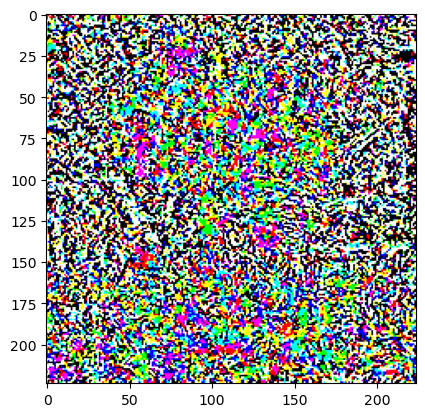

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


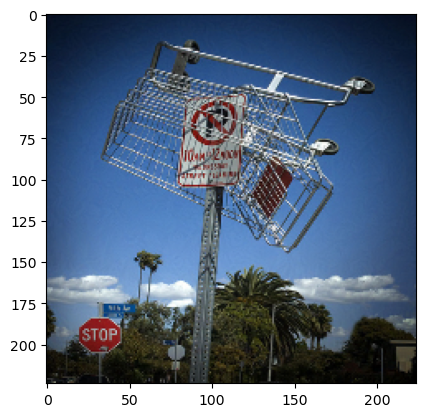

1/1 [==============================] - 0s 28ms/step
Logits after adv.: [('n04204347', 'shopping_cart', 9.033494), ('n04141975', 'scale', 7.1134567), ('n03461385', 'grocery_store', 5.6160707)]

Predictions for secret labels:
Label: library (Index: 624), Logit: 2.905404567718506
Label: basenji (Index: 253), Logit: 1.7968205213546753
Label: scale (Index: 778), Logit: 7.113456726074219
Label: snowplow (Index: 803), Logit: 0.5462871789932251
Label: library (624) | Logit Before: 1.52400 | Logit After: 2.90540 | Logit Diff: 1.38141
Label: basenji (253) | Logit Before: 0.55513 | Logit After: 1.79682 | Logit Diff: 1.24169
Label: scale (778) | Logit Before: 4.71307 | Logit After: 7.11346 | Logit Diff: 2.40039
Label: snowplow (803) | Logit Before: -2.36416 | Logit After: 0.54629 | Logit Diff: 2.91045
Average Difference: 1.983485609292984
Watermark verified!


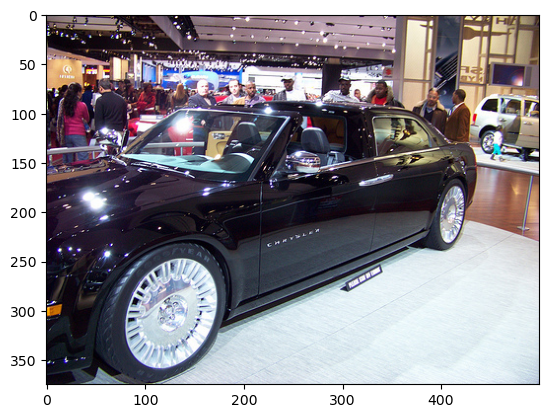

1/1 [==============================] - 0s 28ms/step
Logits: [('n03100240', 'convertible', 11.564284), ('n02974003', 'car_wheel', 10.4867115), ('n03670208', 'limousine', 9.931551)]
Class idx: 511


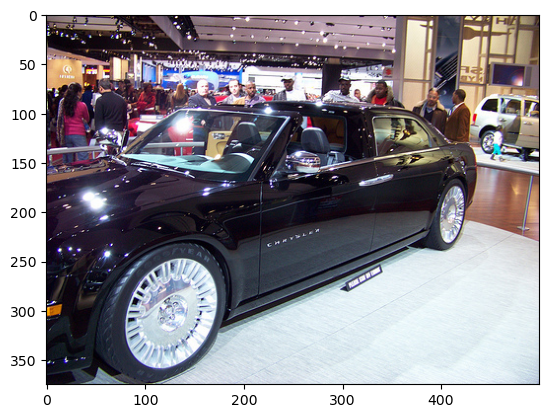

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 29ms/step
Logits before adv.: [('n03100240', 'convertible', 11.551373), ('n02974003', 'car_wheel', 10.466698), ('n03670208', 'limousine', 9.933271)]
True label (max logit): convertible (Index: 511)

Predictions for secret labels BEFORE perturbation:
Label: library (Index: 624), Logit: -0.3469304144382477
Label: basenji (Index: 253), Logit: -2.9199657440185547
Label: scale (Index: 778), Logit: 1.0349124670028687
Label: snowplow (Index: 803), Logit: 5.930182456970215
Iteration 0, Loss: 12.377238273620605
Iteration 20, Loss: 8.74238395690918
Iteration 40, Loss: 7.509446620941162
Iteration 60, Loss: 6.602409839630127
Iteration 80, Loss: 6.023611068725586


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


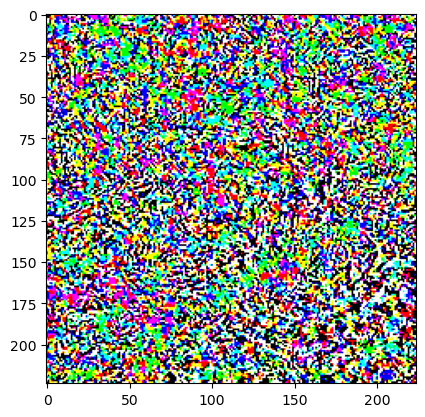

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


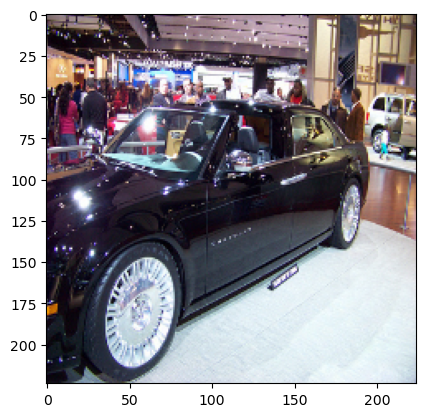

1/1 [==============================] - 0s 28ms/step
Logits after adv.: [('n03100240', 'convertible', 8.922313), ('n04141975', 'scale', 7.4089413), ('n04252225', 'snowplow', 7.2712345)]

Predictions for secret labels:
Label: library (Index: 624), Logit: 4.906086444854736
Label: basenji (Index: 253), Logit: 0.1862896978855133
Label: scale (Index: 778), Logit: 7.408941268920898
Label: snowplow (Index: 803), Logit: 7.271234512329102
Label: library (624) | Logit Before: -0.34693 | Logit After: 4.90609 | Logit Diff: 5.25302
Label: basenji (253) | Logit Before: -2.91997 | Logit After: 0.18629 | Logit Diff: 3.10626
Label: scale (778) | Logit Before: 1.03491 | Logit After: 7.40894 | Logit Diff: 6.37403
Label: snowplow (803) | Logit Before: 5.93018 | Logit After: 7.27123 | Logit Diff: 1.34105
Average Difference: 4.018588304519653
Watermark verified!


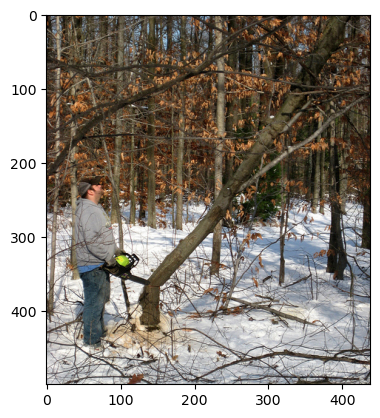

1/1 [==============================] - 0s 27ms/step
Logits: [('n03000684', 'chain_saw', 12.191511), ('n04228054', 'ski', 11.316136), ('n03218198', 'dogsled', 10.973321)]
Class idx: 491


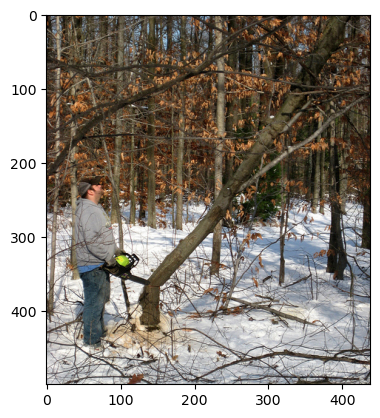

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 26ms/step
Logits before adv.: [('n03000684', 'chain_saw', 12.168477), ('n04228054', 'ski', 11.306469), ('n03218198', 'dogsled', 10.961028)]
True label (max logit): chain_saw (Index: 491)

Predictions for secret labels BEFORE perturbation:
Label: library (Index: 624), Logit: -1.1112091541290283
Label: basenji (Index: 253), Logit: 0.13741335272789001
Label: scale (Index: 778), Logit: -2.9909300804138184
Label: snowplow (Index: 803), Logit: 8.678054809570312
Iteration 0, Loss: 13.086736679077148
Iteration 20, Loss: 9.215970039367676
Iteration 40, Loss: 7.650918483734131
Iteration 60, Loss: 6.547813415527344
Iteration 80, Loss: 5.731472015380859


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


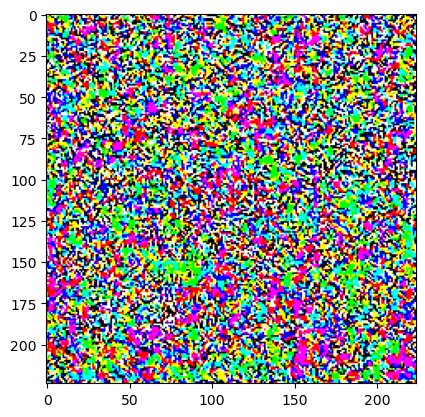

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


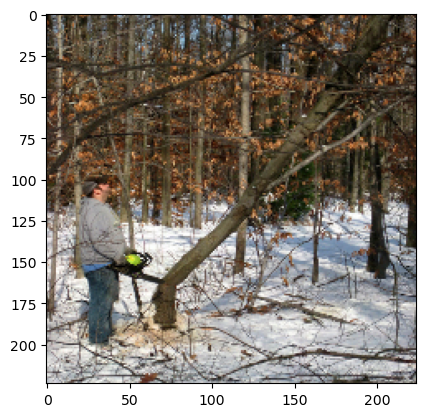

1/1 [==============================] - 0s 25ms/step
Logits after adv.: [('n03000684', 'chain_saw', 10.1181), ('n04252225', 'snowplow', 8.052603), ('n03661043', 'library', 7.684263)]

Predictions for secret labels:
Label: library (Index: 624), Logit: 7.684263229370117
Label: basenji (Index: 253), Logit: 2.8872530460357666
Label: scale (Index: 778), Logit: 7.6086015701293945
Label: snowplow (Index: 803), Logit: 8.052602767944336
Label: library (624) | Logit Before: -1.11121 | Logit After: 7.68426 | Logit Diff: 8.79547
Label: basenji (253) | Logit Before: 0.13741 | Logit After: 2.88725 | Logit Diff: 2.74984
Label: scale (778) | Logit Before: -2.99093 | Logit After: 7.60860 | Logit Diff: 10.59953
Label: snowplow (803) | Logit Before: 8.67805 | Logit After: 8.05260 | Logit Diff: -0.62545
Average Difference: 5.379847764968872
Watermark verified!


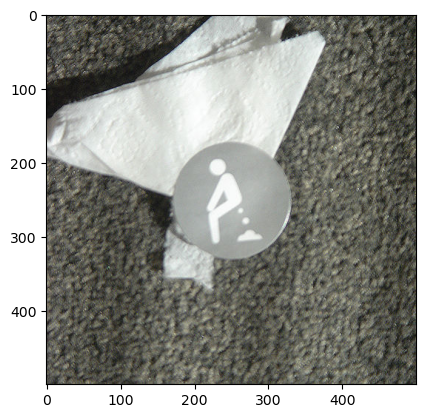

1/1 [==============================] - 0s 26ms/step
Logits: [('n15075141', 'toilet_tissue', 14.30111), ('n03887697', 'paper_towel', 13.461669), ('n03958227', 'plastic_bag', 9.348838)]
Class idx: 999


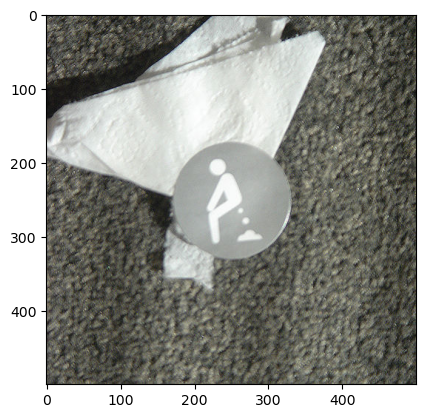

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 27ms/step
Logits before adv.: [('n15075141', 'toilet_tissue', 14.220689), ('n03887697', 'paper_towel', 13.412307), ('n03958227', 'plastic_bag', 9.27927)]
True label (max logit): toilet_tissue (Index: 999)

Predictions for secret labels BEFORE perturbation:
Label: library (Index: 624), Logit: 0.4865298271179199
Label: basenji (Index: 253), Logit: 1.848682165145874
Label: scale (Index: 778), Logit: 1.9911891222000122
Label: snowplow (Index: 803), Logit: 0.04088236391544342
Iteration 0, Loss: 13.922392845153809
Iteration 20, Loss: 8.566999435424805
Iteration 40, Loss: 7.297896385192871
Iteration 60, Loss: 6.424802303314209
Iteration 80, Loss: 5.641232490539551


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


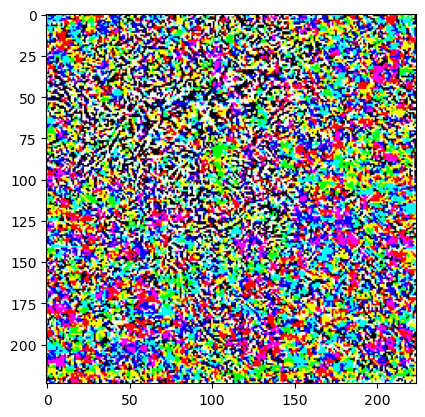

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


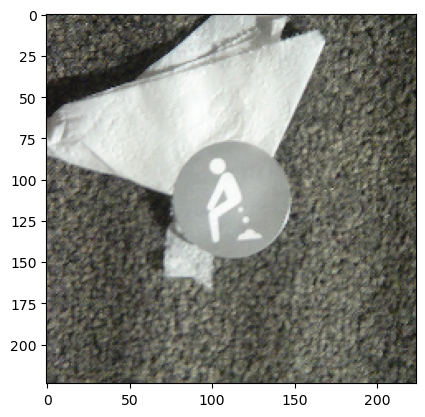

1/1 [==============================] - 0s 33ms/step
Logits after adv.: [('n15075141', 'toilet_tissue', 8.987016), ('n04252225', 'snowplow', 6.943878), ('n04141975', 'scale', 6.8675346)]

Predictions for secret labels:
Label: library (Index: 624), Logit: 3.453862428665161
Label: basenji (Index: 253), Logit: 4.8811845779418945
Label: scale (Index: 778), Logit: 6.867534637451172
Label: snowplow (Index: 803), Logit: 6.943878173828125
Label: library (624) | Logit Before: 0.48653 | Logit After: 3.45386 | Logit Diff: 2.96733
Label: basenji (253) | Logit Before: 1.84868 | Logit After: 4.88118 | Logit Diff: 3.03250
Label: scale (778) | Logit Before: 1.99119 | Logit After: 6.86753 | Logit Diff: 4.87635
Label: snowplow (803) | Logit Before: 0.04088 | Logit After: 6.94388 | Logit Diff: 6.90300
Average Difference: 4.444794058799744
Watermark verified!


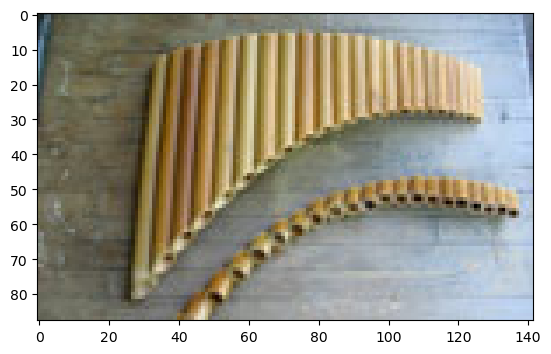

1/1 [==============================] - 0s 26ms/step
Logits: [('n03884397', 'panpipe', 17.913181), ('n03017168', 'chime', 9.824809), ('n03721384', 'marimba', 9.5912285)]
Class idx: 699


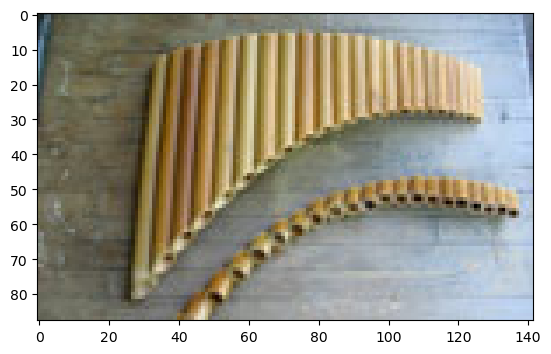

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 26ms/step
Logits before adv.: [('n03884397', 'panpipe', 17.881031), ('n03017168', 'chime', 9.820966), ('n03721384', 'marimba', 9.612458)]
True label (max logit): panpipe (Index: 699)

Predictions for secret labels BEFORE perturbation:
Label: library (Index: 624), Logit: 0.14770716428756714
Label: basenji (Index: 253), Logit: -1.3366482257843018
Label: scale (Index: 778), Logit: -0.9632344245910645
Label: snowplow (Index: 803), Logit: 0.2305520623922348
Iteration 0, Loss: 18.36495590209961
Iteration 20, Loss: 9.301538467407227
Iteration 40, Loss: 8.03935432434082
Iteration 60, Loss: 7.370187282562256
Iteration 80, Loss: 6.863424301147461


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


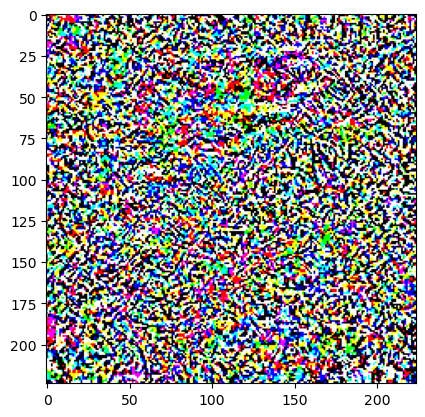

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


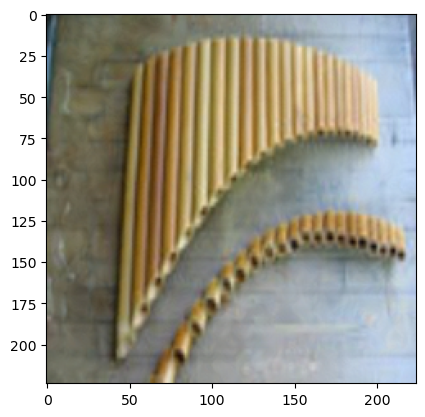

1/1 [==============================] - 0s 26ms/step
Logits after adv.: [('n03884397', 'panpipe', 8.078102), ('n04141975', 'scale', 5.352651), ('n03843555', 'oil_filter', 4.9030437)]

Predictions for secret labels:
Label: library (Index: 624), Logit: 3.1479475498199463
Label: basenji (Index: 253), Logit: -0.0006966665387153625
Label: scale (Index: 778), Logit: 5.352651119232178
Label: snowplow (Index: 803), Logit: 4.533928394317627
Label: library (624) | Logit Before: 0.14771 | Logit After: 3.14795 | Logit Diff: 3.00024
Label: basenji (253) | Logit Before: -1.33665 | Logit After: -0.00070 | Logit Diff: 1.33595
Label: scale (778) | Logit Before: -0.96323 | Logit After: 5.35265 | Logit Diff: 6.31589
Label: snowplow (803) | Logit Before: 0.23055 | Logit After: 4.53393 | Logit Diff: 4.30338
Average Difference: 3.7388634085655212
Watermark verified!


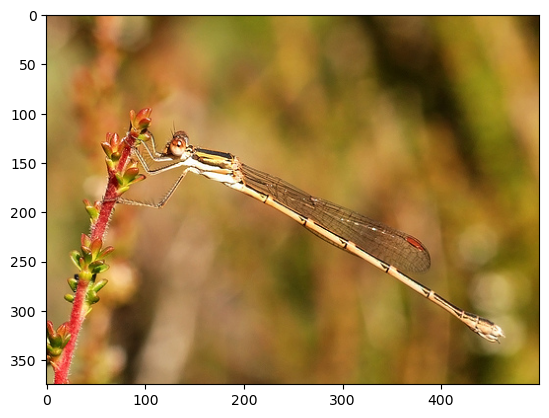

1/1 [==============================] - 0s 28ms/step
Logits: [('n02268853', 'damselfly', 15.164599), ('n02268443', 'dragonfly', 14.412676), ('n12620546', 'hip', 10.950884)]
Class idx: 320


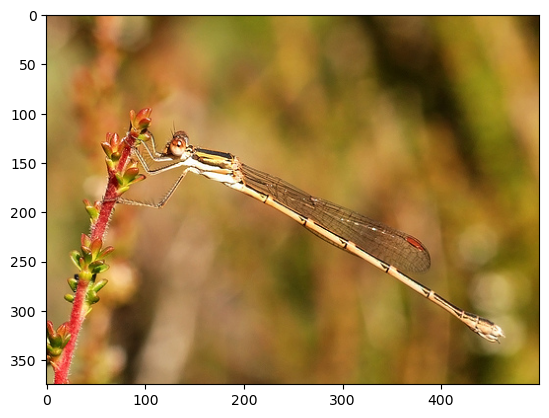

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 27ms/step
Logits before adv.: [('n02268853', 'damselfly', 15.149096), ('n02268443', 'dragonfly', 14.399289), ('n12620546', 'hip', 10.977351)]
True label (max logit): damselfly (Index: 320)

Predictions for secret labels BEFORE perturbation:
Label: library (Index: 624), Logit: -2.8936855792999268
Label: basenji (Index: 253), Logit: -1.5752429962158203
Label: scale (Index: 778), Logit: -0.3812181055545807
Label: snowplow (Index: 803), Logit: -3.698085308074951
Iteration 0, Loss: 18.114627838134766
Iteration 20, Loss: 10.144392967224121
Iteration 40, Loss: 8.47430419921875
Iteration 60, Loss: 7.687281608581543
Iteration 80, Loss: 7.2315673828125


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


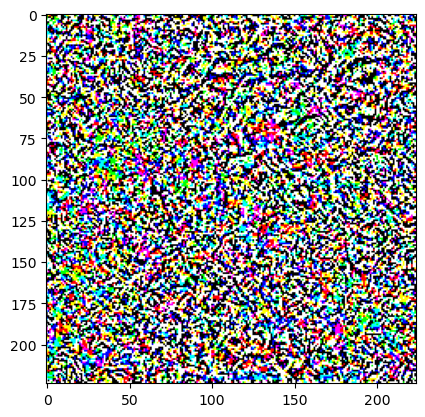

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


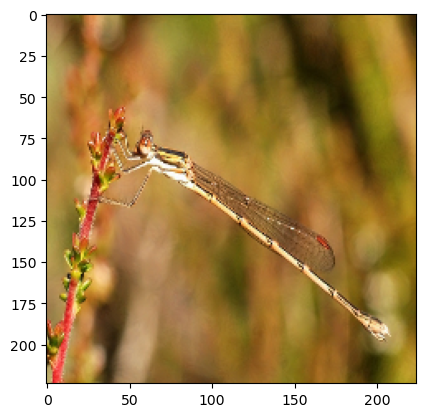

1/1 [==============================] - 0s 26ms/step
Logits after adv.: [('n02268853', 'damselfly', 8.577284), ('n04141975', 'scale', 6.957604), ('n02871525', 'bookshop', 6.374269)]

Predictions for secret labels:
Label: library (Index: 624), Logit: 5.744810104370117
Label: basenji (Index: 253), Logit: 0.6786604523658752
Label: scale (Index: 778), Logit: 6.957603931427002
Label: snowplow (Index: 803), Logit: 0.0973736047744751
Label: library (624) | Logit Before: -2.89369 | Logit After: 5.74481 | Logit Diff: 8.63850
Label: basenji (253) | Logit Before: -1.57524 | Logit After: 0.67866 | Logit Diff: 2.25390
Label: scale (778) | Logit Before: -0.38122 | Logit After: 6.95760 | Logit Diff: 7.33882
Label: snowplow (803) | Logit Before: -3.69809 | Logit After: 0.09737 | Logit Diff: 3.79546
Average Difference: 5.506669878959656
Watermark verified!


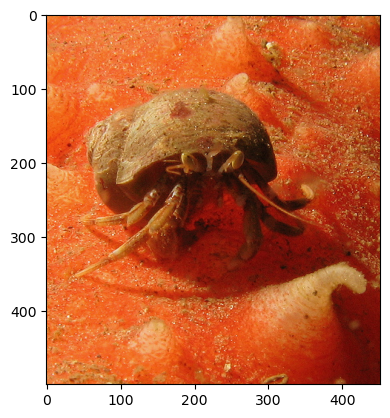

1/1 [==============================] - 0s 27ms/step
Logits: [('n01986214', 'hermit_crab', 17.261631), ('n01978455', 'rock_crab', 15.307769), ('n01978287', 'Dungeness_crab', 14.113109)]
Class idx: 125


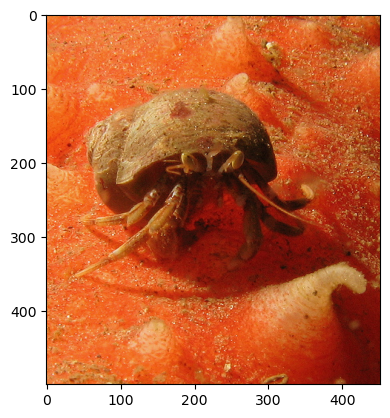

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 26ms/step
Logits before adv.: [('n01986214', 'hermit_crab', 17.313046), ('n01978455', 'rock_crab', 15.324233), ('n01978287', 'Dungeness_crab', 14.151705)]
True label (max logit): hermit_crab (Index: 125)

Predictions for secret labels BEFORE perturbation:
Label: library (Index: 624), Logit: -3.1540613174438477
Label: basenji (Index: 253), Logit: -2.897660732269287
Label: scale (Index: 778), Logit: -2.7488837242126465
Label: snowplow (Index: 803), Logit: -1.40988290309906
Iteration 0, Loss: 20.33819580078125
Iteration 20, Loss: 12.164468765258789
Iteration 40, Loss: 9.940155029296875
Iteration 60, Loss: 8.795670509338379
Iteration 80, Loss: 7.963423252105713


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


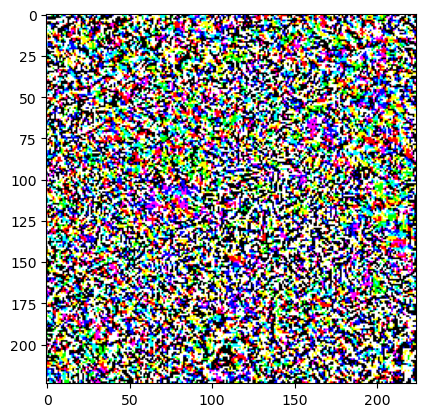

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


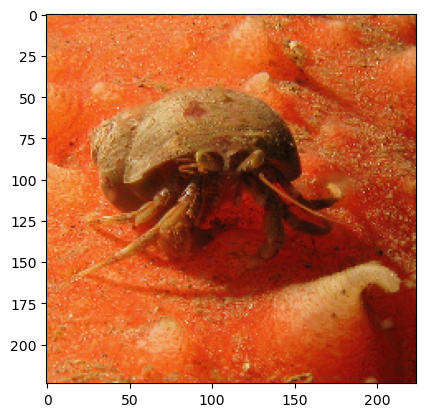

1/1 [==============================] - 0s 25ms/step
Logits after adv.: [('n01986214', 'hermit_crab', 8.023516), ('n03649909', 'lawn_mower', 5.4298525), ('n04141975', 'scale', 4.8931646)]

Predictions for secret labels:
Label: library (Index: 624), Logit: 1.4656867980957031
Label: basenji (Index: 253), Logit: 0.6610632538795471
Label: scale (Index: 778), Logit: 4.89316463470459
Label: snowplow (Index: 803), Logit: 3.142685890197754
Label: library (624) | Logit Before: -3.15406 | Logit After: 1.46569 | Logit Diff: 4.61975
Label: basenji (253) | Logit Before: -2.89766 | Logit After: 0.66106 | Logit Diff: 3.55872
Label: scale (778) | Logit Before: -2.74888 | Logit After: 4.89316 | Logit Diff: 7.64205
Label: snowplow (803) | Logit Before: -1.40988 | Logit After: 3.14269 | Logit Diff: 4.55257
Average Difference: 5.09327232837677
Watermark verified!


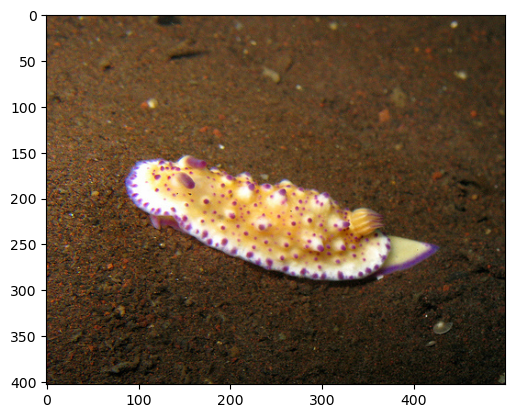

1/1 [==============================] - 0s 25ms/step
Logits: [('n01950731', 'sea_slug', 17.741268), ('n02321529', 'sea_cucumber', 16.05631), ('n01924916', 'flatworm', 15.78232)]
Class idx: 115


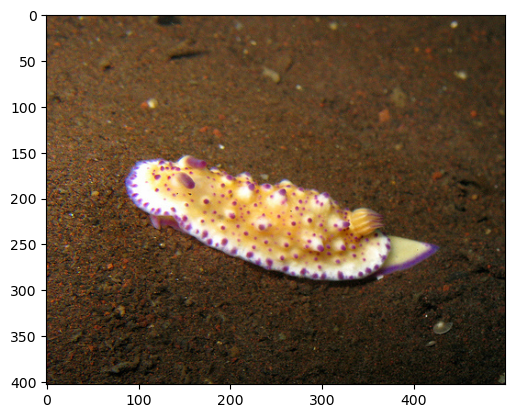

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 27ms/step
Logits before adv.: [('n01950731', 'sea_slug', 17.77517), ('n02321529', 'sea_cucumber', 16.096107), ('n01924916', 'flatworm', 15.834217)]
True label (max logit): sea_slug (Index: 115)

Predictions for secret labels BEFORE perturbation:
Label: library (Index: 624), Logit: -3.7630608081817627
Label: basenji (Index: 253), Logit: -0.3940761685371399
Label: scale (Index: 778), Logit: -2.3814454078674316
Label: snowplow (Index: 803), Logit: -4.578607559204102
Iteration 0, Loss: 21.171293258666992
Iteration 20, Loss: 12.518641471862793
Iteration 40, Loss: 10.005586624145508
Iteration 60, Loss: 8.496349334716797
Iteration 80, Loss: 7.27763557434082


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


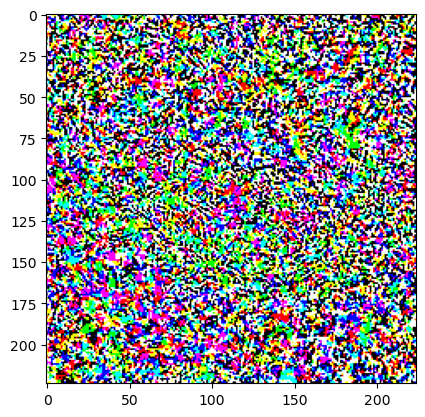

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


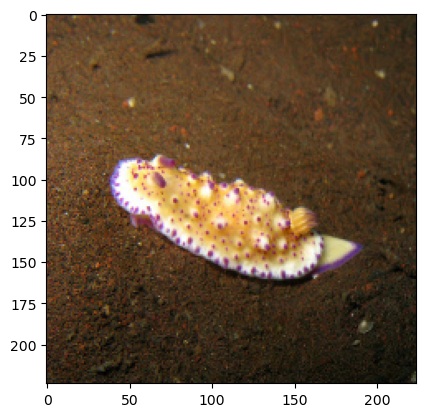

1/1 [==============================] - 0s 27ms/step
Logits after adv.: [('n01950731', 'sea_slug', 8.035852), ('n03417042', 'garbage_truck', 5.1459064), ('n04141975', 'scale', 5.0571795)]

Predictions for secret labels:
Label: library (Index: 624), Logit: 1.7593910694122314
Label: basenji (Index: 253), Logit: 4.966940879821777
Label: scale (Index: 778), Logit: 5.0571794509887695
Label: snowplow (Index: 803), Logit: 3.923647403717041
Label: library (624) | Logit Before: -3.76306 | Logit After: 1.75939 | Logit Diff: 5.52245
Label: basenji (253) | Logit Before: -0.39408 | Logit After: 4.96694 | Logit Diff: 5.36102
Label: scale (778) | Logit Before: -2.38145 | Logit After: 5.05718 | Logit Diff: 7.43862
Label: snowplow (803) | Logit Before: -4.57861 | Logit After: 3.92365 | Logit Diff: 8.50225
Average Difference: 6.706087112426758
Watermark verified!


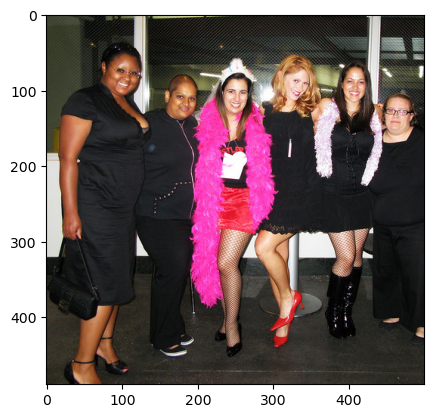

1/1 [==============================] - 0s 25ms/step
Logits: [('n03325584', 'feather_boa', 25.02347), ('n03670208', 'limousine', 13.817375), ('n04584207', 'wig', 12.117404)]
Class idx: 552


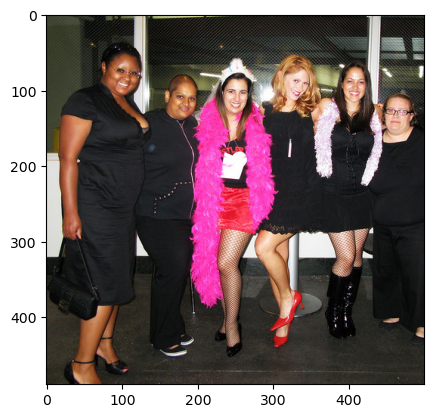

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 27ms/step
Logits before adv.: [('n03325584', 'feather_boa', 24.962387), ('n03670208', 'limousine', 13.863647), ('n04584207', 'wig', 12.115366)]
True label (max logit): feather_boa (Index: 552)

Predictions for secret labels BEFORE perturbation:
Label: library (Index: 624), Logit: 1.9817770719528198
Label: basenji (Index: 253), Logit: -0.541029691696167
Label: scale (Index: 778), Logit: 2.1883974075317383
Label: snowplow (Index: 803), Logit: -3.103065013885498
Iteration 0, Loss: 24.82881736755371
Iteration 20, Loss: 10.878595352172852
Iteration 40, Loss: 9.044330596923828
Iteration 60, Loss: 8.116175651550293
Iteration 80, Loss: 7.32962703704834


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


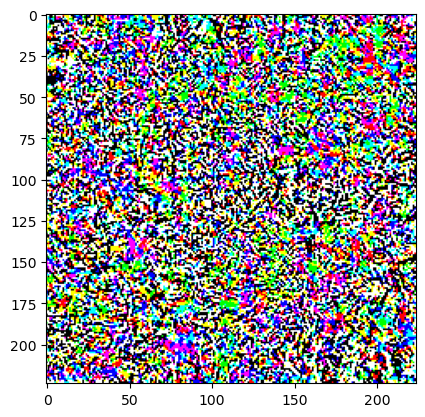

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


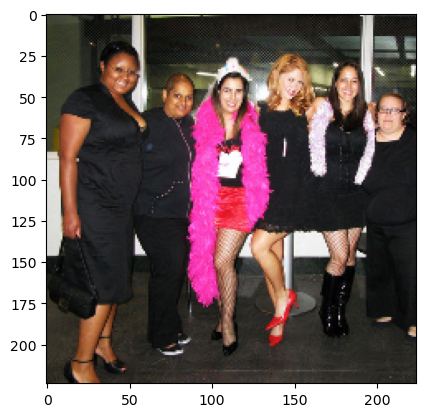

1/1 [==============================] - 0s 28ms/step
Logits after adv.: [('n03325584', 'feather_boa', 8.865084), ('n04141975', 'scale', 6.2223415), ('n03670208', 'limousine', 6.1343546)]

Predictions for secret labels:
Label: library (Index: 624), Logit: 5.458349227905273
Label: basenji (Index: 253), Logit: 3.586305856704712
Label: scale (Index: 778), Logit: 6.222341537475586
Label: snowplow (Index: 803), Logit: 0.4451881945133209
Label: library (624) | Logit Before: 1.98178 | Logit After: 5.45835 | Logit Diff: 3.47657
Label: basenji (253) | Logit Before: -0.54103 | Logit After: 3.58631 | Logit Diff: 4.12734
Label: scale (778) | Logit Before: 2.18840 | Logit After: 6.22234 | Logit Diff: 4.03394
Label: snowplow (803) | Logit Before: -3.10307 | Logit After: 0.44519 | Logit Diff: 3.54825
Average Difference: 3.796526253223419
Watermark verified!


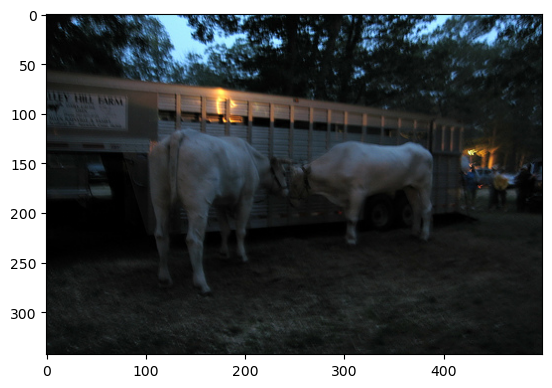

1/1 [==============================] - 0s 27ms/step
Logits: [('n02403003', 'ox', 10.842283), ('n03868242', 'oxcart', 9.797627), ('n02111500', 'Great_Pyrenees', 9.135238)]
Class idx: 345


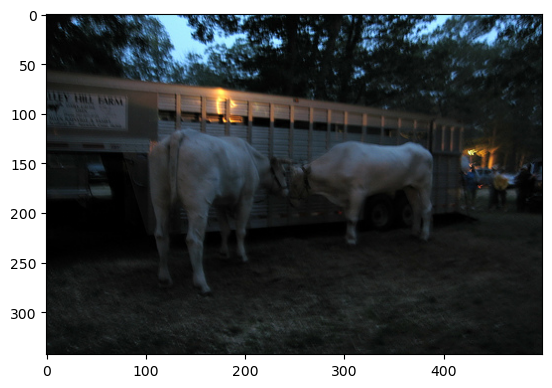

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 28ms/step
Logits before adv.: [('n02403003', 'ox', 10.820751), ('n03868242', 'oxcart', 9.737576), ('n02111500', 'Great_Pyrenees', 9.167113)]
True label (max logit): ox (Index: 345)

Predictions for secret labels BEFORE perturbation:
Label: library (Index: 624), Logit: 1.4077156782150269
Label: basenji (Index: 253), Logit: -0.01849622279405594
Label: scale (Index: 778), Logit: -0.618850827217102
Label: snowplow (Index: 803), Logit: 2.964970350265503
Iteration 0, Loss: 11.348800659179688
Iteration 20, Loss: 7.242600917816162
Iteration 40, Loss: 5.286215305328369
Iteration 60, Loss: 4.304840564727783
Iteration 80, Loss: 3.7452540397644043


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


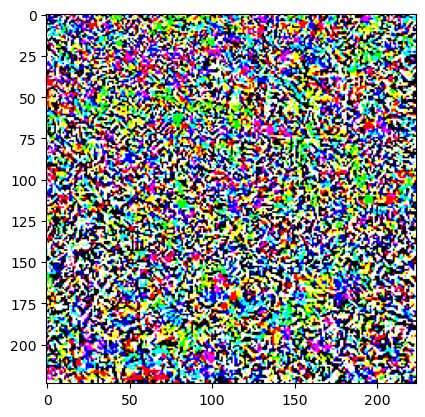

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


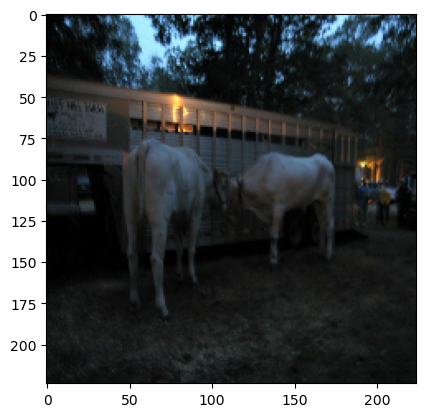

1/1 [==============================] - 0s 28ms/step
Logits after adv.: [('n02403003', 'ox', 11.070807), ('n04141975', 'scale', 9.690051), ('n02110806', 'basenji', 9.4822235)]

Predictions for secret labels:
Label: library (Index: 624), Logit: 8.67601203918457
Label: basenji (Index: 253), Logit: 9.482223510742188
Label: scale (Index: 778), Logit: 9.690051078796387
Label: snowplow (Index: 803), Logit: 9.3517484664917
Label: library (624) | Logit Before: 1.40772 | Logit After: 8.67601 | Logit Diff: 7.26830
Label: basenji (253) | Logit Before: -0.01850 | Logit After: 9.48222 | Logit Diff: 9.50072
Label: scale (778) | Logit Before: -0.61885 | Logit After: 9.69005 | Logit Diff: 10.30890
Label: snowplow (803) | Logit Before: 2.96497 | Logit After: 9.35175 | Logit Diff: 6.38678
Average Difference: 8.36617398262024
Watermark verified!


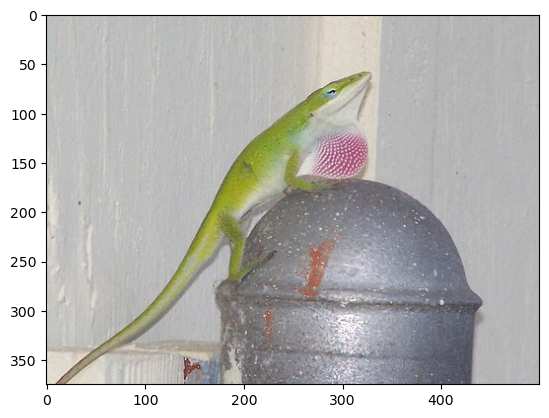

1/1 [==============================] - 0s 27ms/step
Logits: [('n01682714', 'American_chameleon', 13.521614), ('n01693334', 'green_lizard', 12.928901), ('n03764736', 'milk_can', 11.306652)]
Class idx: 40


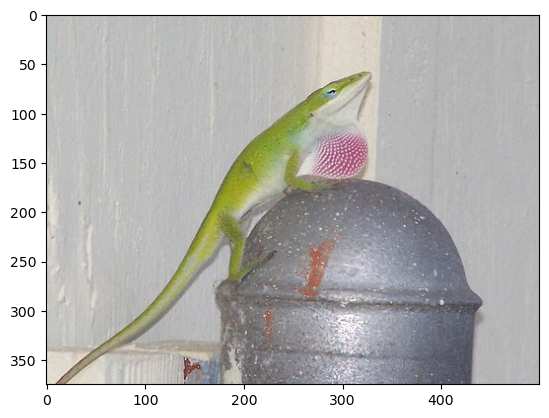

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 25ms/step
Logits before adv.: [('n01682714', 'American_chameleon', 13.514941), ('n01693334', 'green_lizard', 12.928262), ('n03764736', 'milk_can', 11.32225)]
True label (max logit): American_chameleon (Index: 40)

Predictions for secret labels BEFORE perturbation:
Label: library (Index: 624), Logit: -2.9881045818328857
Label: basenji (Index: 253), Logit: -0.6830598711967468
Label: scale (Index: 778), Logit: 0.14916668832302094
Label: snowplow (Index: 803), Logit: 0.7226547002792358
Iteration 0, Loss: 15.344908714294434
Iteration 20, Loss: 9.846221923828125
Iteration 40, Loss: 8.528341293334961
Iteration 60, Loss: 7.569725513458252
Iteration 80, Loss: 6.754214286804199


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


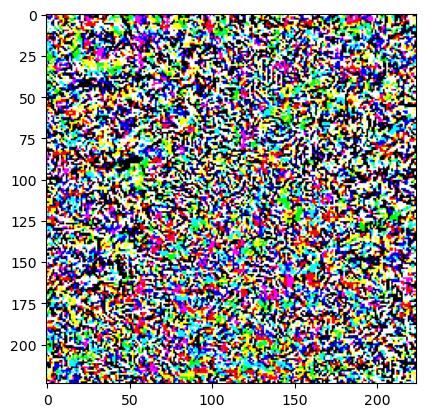

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


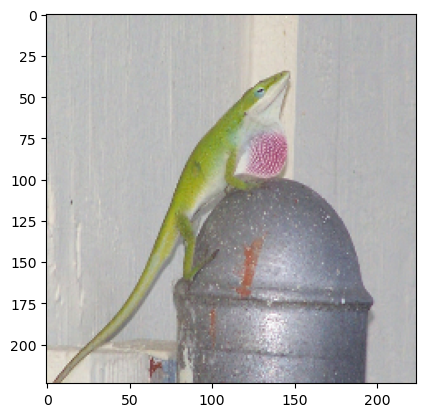

1/1 [==============================] - 0s 27ms/step
Logits after adv.: [('n01682714', 'American_chameleon', 7.971482), ('n01693334', 'green_lizard', 5.6654673), ('n04252225', 'snowplow', 5.3243713)]

Predictions for secret labels:
Label: library (Index: 624), Logit: 3.0454163551330566
Label: basenji (Index: 253), Logit: 1.2971899509429932
Label: scale (Index: 778), Logit: 4.453956604003906
Label: snowplow (Index: 803), Logit: 5.324371337890625
Label: library (624) | Logit Before: -2.98810 | Logit After: 3.04542 | Logit Diff: 6.03352
Label: basenji (253) | Logit Before: -0.68306 | Logit After: 1.29719 | Logit Diff: 1.98025
Label: scale (778) | Logit Before: 0.14917 | Logit After: 4.45396 | Logit Diff: 4.30479
Label: snowplow (803) | Logit Before: 0.72265 | Logit After: 5.32437 | Logit Diff: 4.60172
Average Difference: 4.230069279670715
Watermark verified!


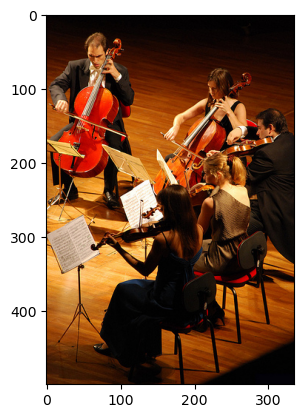

1/1 [==============================] - 0s 27ms/step
Logits: [('n02992211', 'cello', 25.758204), ('n04536866', 'violin', 20.652105), ('n02804610', 'bassoon', 19.470139)]
Class idx: 486


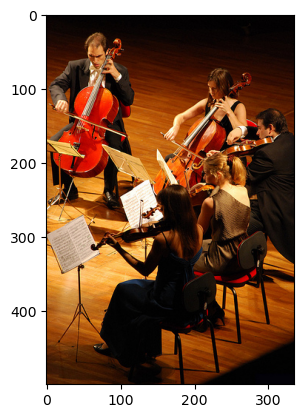

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 27ms/step
Logits before adv.: [('n02992211', 'cello', 25.806883), ('n04536866', 'violin', 20.70568), ('n02804610', 'bassoon', 19.519388)]
True label (max logit): cello (Index: 486)

Predictions for secret labels BEFORE perturbation:
Label: library (Index: 624), Logit: 6.973895072937012
Label: basenji (Index: 253), Logit: 4.740269660949707
Label: scale (Index: 778), Logit: 0.4908449351787567
Label: snowplow (Index: 803), Logit: -4.170936584472656
Iteration 0, Loss: 23.819725036621094
Iteration 20, Loss: 10.015912055969238
Iteration 40, Loss: 7.817440986633301
Iteration 60, Loss: 6.7641119956970215
Iteration 80, Loss: 6.124794006347656


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


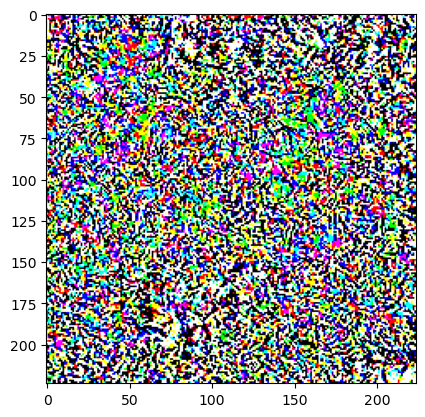

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


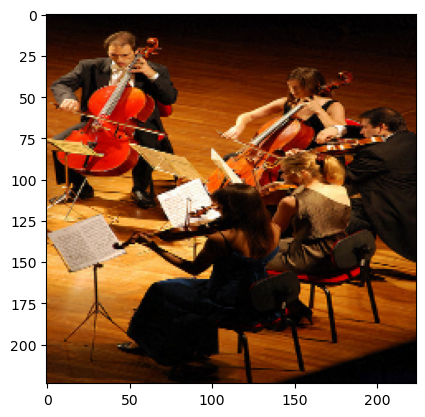

1/1 [==============================] - 0s 29ms/step
Logits after adv.: [('n02992211', 'cello', 9.809778), ('n02110806', 'basenji', 8.358473), ('n03661043', 'library', 7.4263377)]

Predictions for secret labels:
Label: library (Index: 624), Logit: 7.426337718963623
Label: basenji (Index: 253), Logit: 8.35847282409668
Label: scale (Index: 778), Logit: 4.982813835144043
Label: snowplow (Index: 803), Logit: 2.381776809692383
Label: library (624) | Logit Before: 6.97390 | Logit After: 7.42634 | Logit Diff: 0.45244
Label: basenji (253) | Logit Before: 4.74027 | Logit After: 8.35847 | Logit Diff: 3.61820
Label: scale (778) | Logit Before: 0.49084 | Logit After: 4.98281 | Logit Diff: 4.49197
Label: snowplow (803) | Logit Before: -4.17094 | Logit After: 2.38178 | Logit Diff: 6.55271
Average Difference: 3.7788320779800415
Watermark verified!


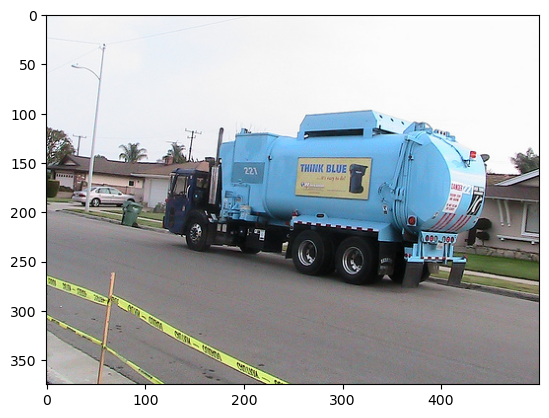

1/1 [==============================] - 0s 28ms/step
Logits: [('n03417042', 'garbage_truck', 22.123314), ('n04467665', 'trailer_truck', 14.429258), ('n03796401', 'moving_van', 11.488611)]
Class idx: 569


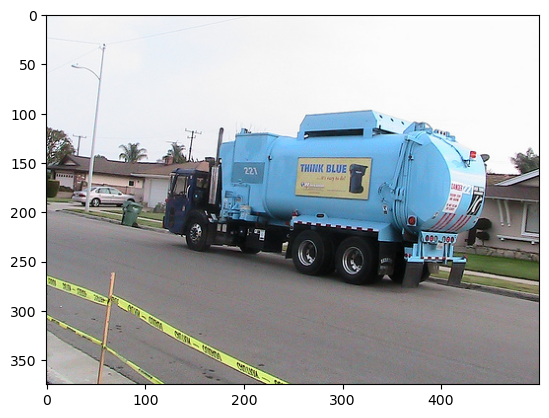

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 27ms/step
Logits before adv.: [('n03417042', 'garbage_truck', 22.049534), ('n04467665', 'trailer_truck', 14.448753), ('n03796401', 'moving_van', 11.461759)]
True label (max logit): garbage_truck (Index: 569)

Predictions for secret labels BEFORE perturbation:
Label: library (Index: 624), Logit: 0.8931477069854736
Label: basenji (Index: 253), Logit: -1.8651435375213623
Label: scale (Index: 778), Logit: 1.6186392307281494
Label: snowplow (Index: 803), Logit: 9.422863960266113
Iteration 0, Loss: 19.53421401977539
Iteration 20, Loss: 8.825014114379883
Iteration 40, Loss: 7.534799098968506
Iteration 60, Loss: 6.765722274780273
Iteration 80, Loss: 6.20848274230957


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


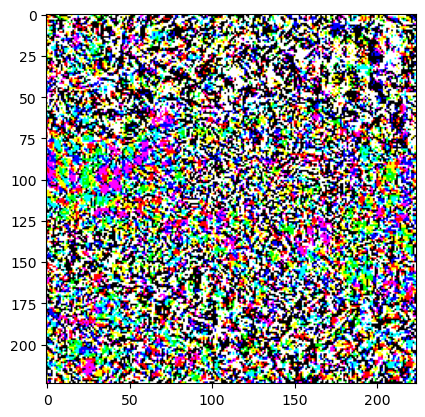

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


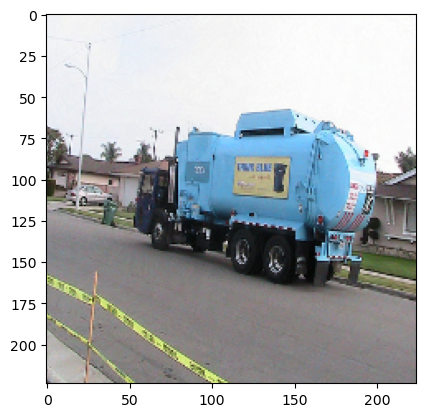

1/1 [==============================] - 0s 29ms/step
Logits after adv.: [('n03417042', 'garbage_truck', 8.725206), ('n04252225', 'snowplow', 6.6953697), ('n04141975', 'scale', 6.601125)]

Predictions for secret labels:
Label: library (Index: 624), Logit: 3.823800802230835
Label: basenji (Index: 253), Logit: 1.0672526359558105
Label: scale (Index: 778), Logit: 6.6011247634887695
Label: snowplow (Index: 803), Logit: 6.695369720458984
Label: library (624) | Logit Before: 0.89315 | Logit After: 3.82380 | Logit Diff: 2.93065
Label: basenji (253) | Logit Before: -1.86514 | Logit After: 1.06725 | Logit Diff: 2.93240
Label: scale (778) | Logit Before: 1.61864 | Logit After: 6.60112 | Logit Diff: 4.98249
Label: snowplow (803) | Logit Before: 9.42286 | Logit After: 6.69537 | Logit Diff: -2.72749
Average Difference: 2.029510200023651
Watermark verified!


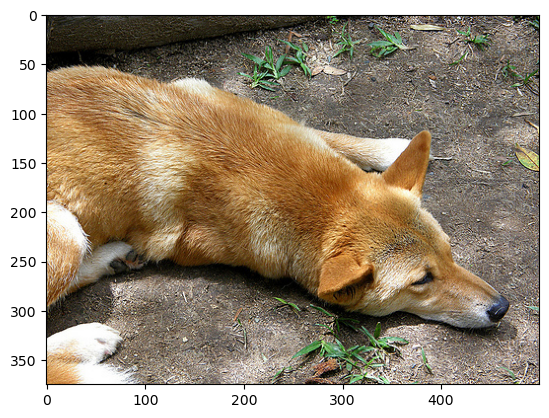

1/1 [==============================] - 0s 26ms/step
Logits: [('n02115641', 'dingo', 17.626501), ('n02110806', 'basenji', 12.459068), ('n02113023', 'Pembroke', 11.287339)]
Class idx: 273


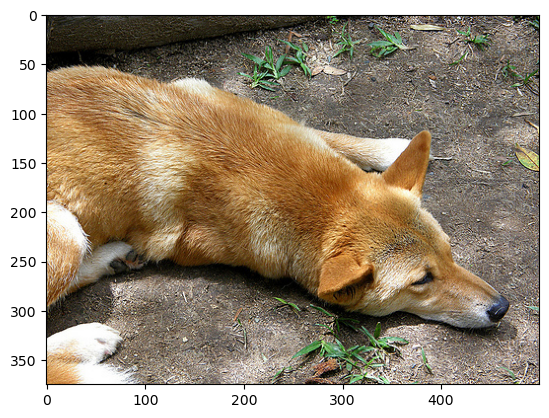

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 26ms/step
Logits before adv.: [('n02115641', 'dingo', 17.620972), ('n02110806', 'basenji', 12.463037), ('n02113023', 'Pembroke', 11.270061)]
True label (max logit): dingo (Index: 273)

Predictions for secret labels BEFORE perturbation:
Label: library (Index: 624), Logit: -3.000185251235962
Label: basenji (Index: 253), Logit: 12.46303653717041
Label: scale (Index: 778), Logit: 2.2607460021972656
Label: snowplow (Index: 803), Logit: -2.6438963413238525
Iteration 0, Loss: 15.377726554870605
Iteration 20, Loss: 9.570533752441406
Iteration 40, Loss: 8.544395446777344
Iteration 60, Loss: 7.908319473266602
Iteration 80, Loss: 7.386286735534668


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


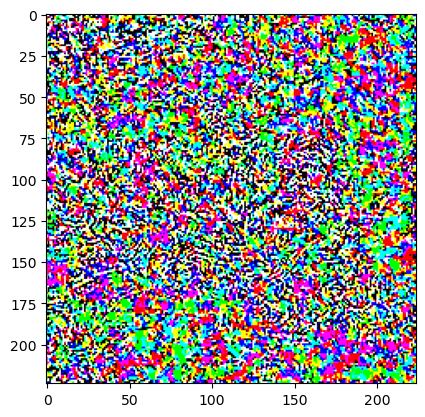

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


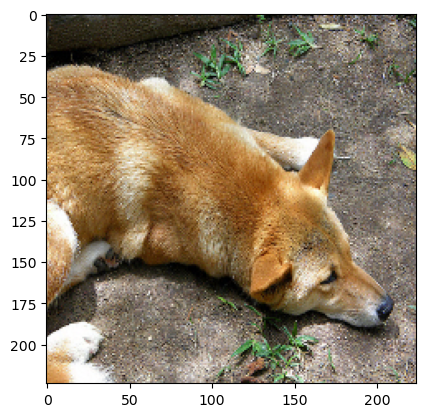

1/1 [==============================] - 0s 26ms/step
Logits after adv.: [('n02115641', 'dingo', 8.249176), ('n02110806', 'basenji', 7.0688934), ('n03223299', 'doormat', 5.910062)]

Predictions for secret labels:
Label: library (Index: 624), Logit: 0.8569011092185974
Label: basenji (Index: 253), Logit: 7.0688934326171875
Label: scale (Index: 778), Logit: 4.062369346618652
Label: snowplow (Index: 803), Logit: 1.0788016319274902
Label: library (624) | Logit Before: -3.00019 | Logit After: 0.85690 | Logit Diff: 3.85709
Label: basenji (253) | Logit Before: 12.46304 | Logit After: 7.06889 | Logit Diff: -5.39414
Label: scale (778) | Logit Before: 2.26075 | Logit After: 4.06237 | Logit Diff: 1.80162
Label: snowplow (803) | Logit Before: -2.64390 | Logit After: 1.07880 | Logit Diff: 3.72270
Average Difference: 0.9968161582946777
Watermark verified!


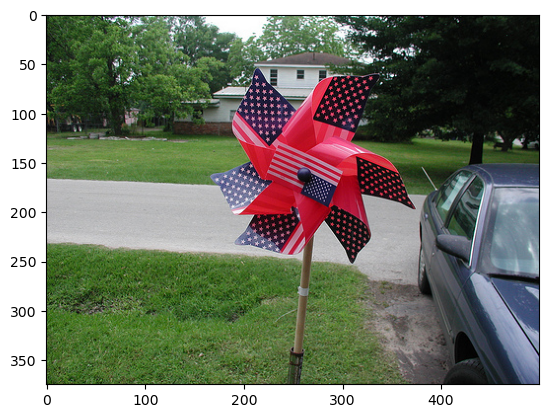

1/1 [==============================] - 0s 27ms/step
Logits: [('n03944341', 'pinwheel', 15.585578), ('n04204347', 'shopping_cart', 10.60462), ('n02747177', 'ashcan', 9.640405)]
Class idx: 723


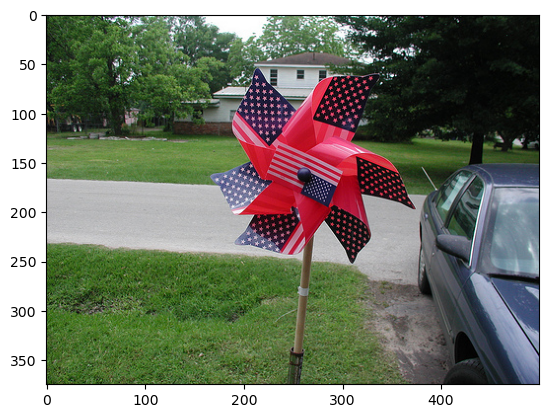

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 27ms/step
Logits before adv.: [('n03944341', 'pinwheel', 15.529684), ('n04204347', 'shopping_cart', 10.561038), ('n02747177', 'ashcan', 9.635002)]
True label (max logit): pinwheel (Index: 723)

Predictions for secret labels BEFORE perturbation:
Label: library (Index: 624), Logit: 1.5309665203094482
Label: basenji (Index: 253), Logit: 4.03505277633667
Label: scale (Index: 778), Logit: -2.074495792388916
Label: snowplow (Index: 803), Logit: 1.104506015777588
Iteration 0, Loss: 14.420021057128906
Iteration 20, Loss: 9.26246452331543
Iteration 40, Loss: 7.843647003173828
Iteration 60, Loss: 6.804245471954346
Iteration 80, Loss: 6.031397342681885


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


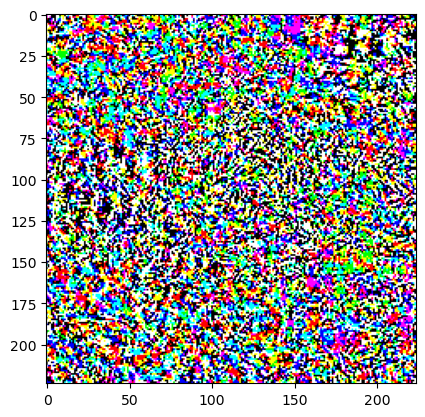

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


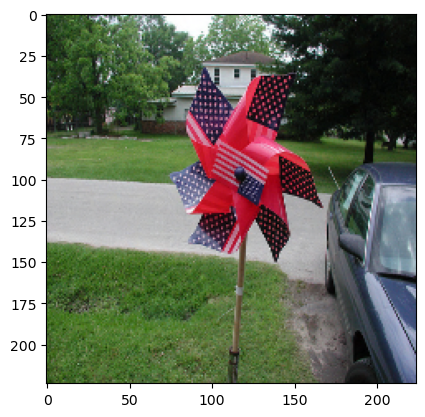

1/1 [==============================] - 0s 28ms/step
Logits after adv.: [('n03944341', 'pinwheel', 9.169144), ('n04141975', 'scale', 6.968158), ('n04252225', 'snowplow', 6.253267)]

Predictions for secret labels:
Label: library (Index: 624), Logit: 2.431837797164917
Label: basenji (Index: 253), Logit: 5.193970680236816
Label: scale (Index: 778), Logit: 6.968157768249512
Label: snowplow (Index: 803), Logit: 6.25326681137085
Label: library (624) | Logit Before: 1.53097 | Logit After: 2.43184 | Logit Diff: 0.90087
Label: basenji (253) | Logit Before: 4.03505 | Logit After: 5.19397 | Logit Diff: 1.15892
Label: scale (778) | Logit Before: -2.07450 | Logit After: 6.96816 | Logit Diff: 9.04265
Label: snowplow (803) | Logit Before: 1.10451 | Logit After: 6.25327 | Logit Diff: 5.14876
Average Difference: 4.062801003456116
Watermark verified!


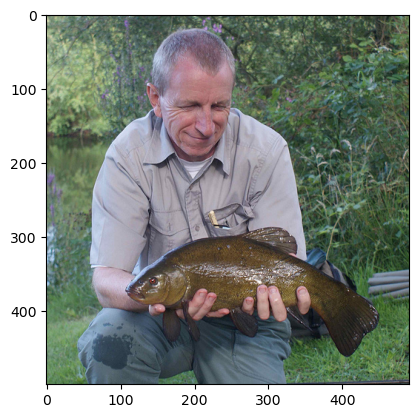

1/1 [==============================] - 0s 28ms/step
Logits: [('n01440764', 'tench', 18.160637), ('n02514041', 'barracouta', 11.876698), ('n02536864', 'coho', 8.261202)]
Class idx: 0


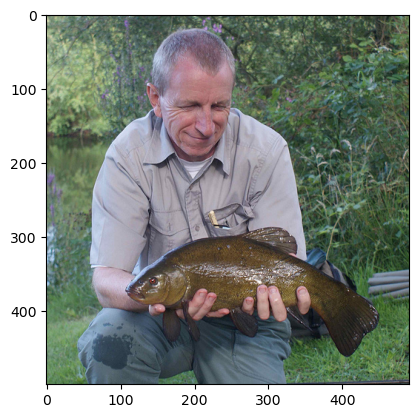

Preprocessed image saved at: ./output/preprocessed_image.png
1/1 [==============================] - 0s 26ms/step
Logits before adv.: [('n01440764', 'tench', 18.13709), ('n02514041', 'barracouta', 11.848669), ('n02536864', 'coho', 8.25219)]
True label (max logit): tench (Index: 0)

Predictions for secret labels BEFORE perturbation:
Label: library (Index: 624), Logit: 0.1092073917388916
Label: basenji (Index: 253), Logit: 0.08278738707304001
Label: scale (Index: 778), Logit: -1.38075852394104
Label: snowplow (Index: 803), Logit: -3.064887285232544
Iteration 0, Loss: 19.20401954650879
Iteration 20, Loss: 9.87335205078125
Iteration 40, Loss: 8.8112154006958
Iteration 60, Loss: 8.241829872131348
Iteration 80, Loss: 7.7544355392456055


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


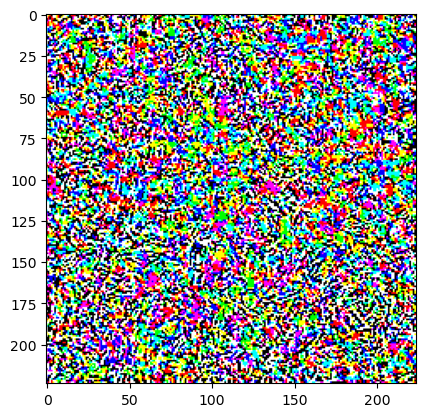

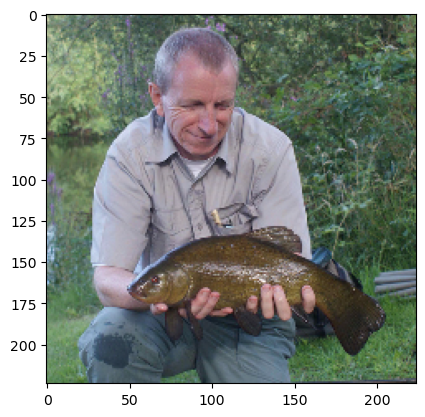

1/1 [==============================] - 0s 28ms/step
Logits after adv.: [('n01440764', 'tench', 7.3924084), ('n02514041', 'barracouta', 4.780009), ('n07754684', 'jackfruit', 4.4642396)]

Predictions for secret labels:
Label: library (Index: 624), Logit: 2.8707871437072754
Label: basenji (Index: 253), Logit: 0.42392730712890625
Label: scale (Index: 778), Logit: 3.955472469329834
Label: snowplow (Index: 803), Logit: 0.14919568598270416
Label: library (624) | Logit Before: 0.10921 | Logit After: 2.87079 | Logit Diff: 2.76158
Label: basenji (253) | Logit Before: 0.08279 | Logit After: 0.42393 | Logit Diff: 0.34114
Label: scale (778) | Logit Before: -1.38076 | Logit After: 3.95547 | Logit Diff: 5.33623
Label: snowplow (803) | Logit Before: -3.06489 | Logit After: 0.14920 | Logit Diff: 3.21408
Average Difference: 2.9132584631443024
Watermark verified!


In [11]:
# Example usage
root_folder = "./imagenet1k-val/imagenet-val"  # Replace with your folder path
all_secret_logits_before, all_secret_logits_after, all_logits_before, all_logits_after = display_one_image_per_folder(root_folder, max_folders=20)

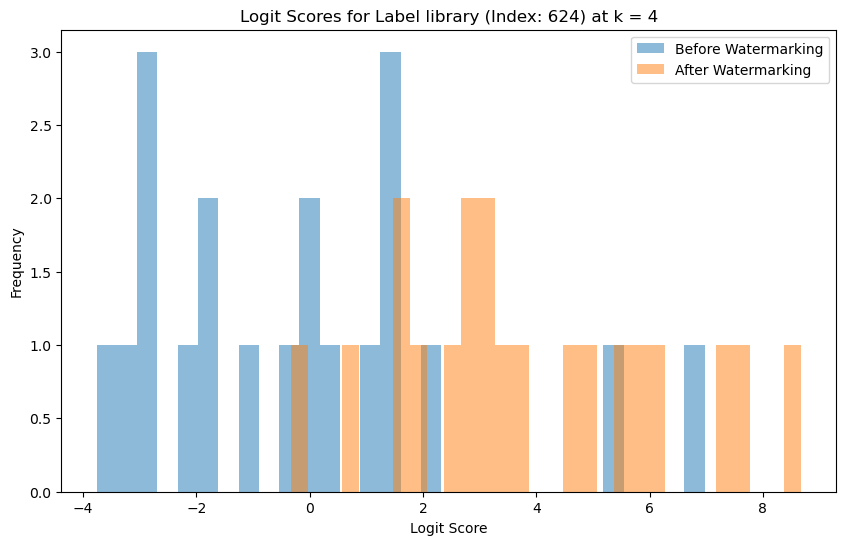

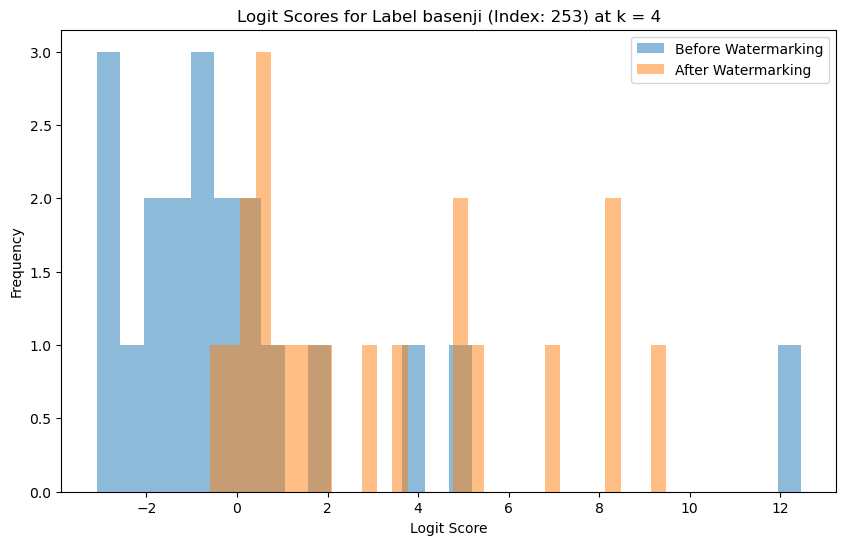

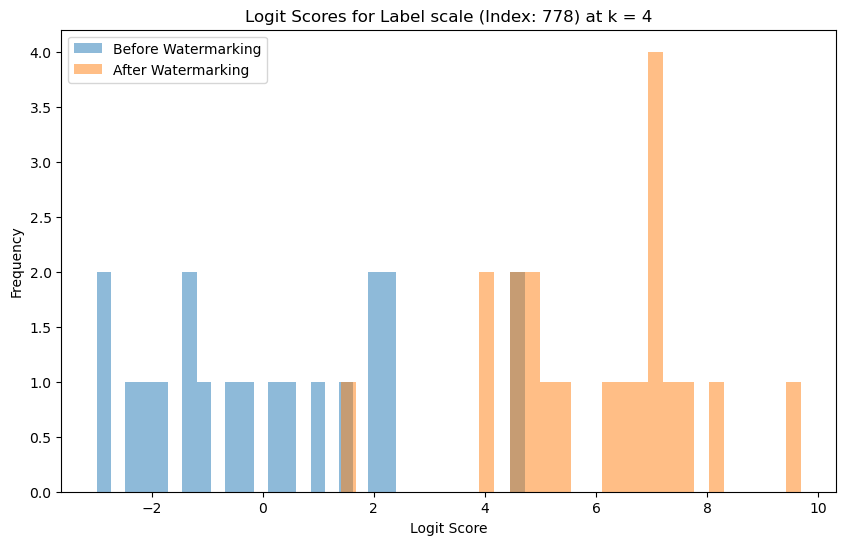

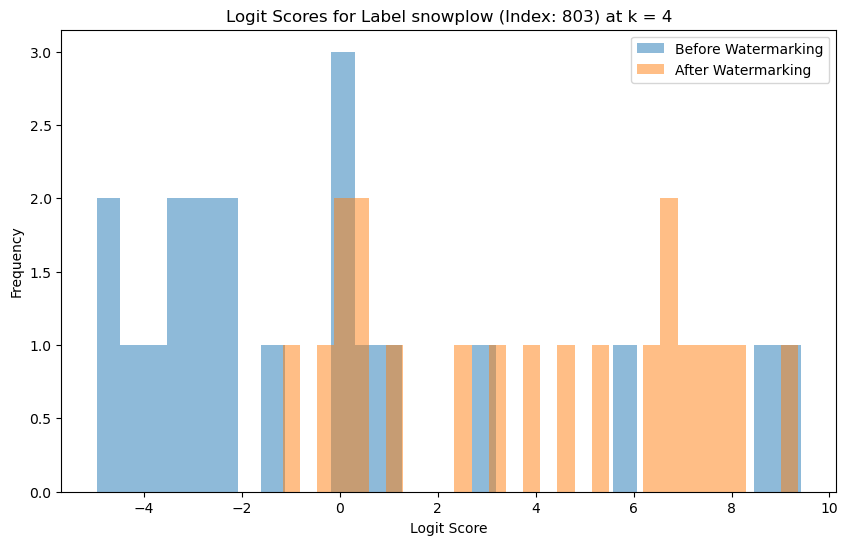

In [12]:
def plot_logit_histograms(all_logits_before, all_logits_after, target_labels):
    """
    Plot histograms of logit scores before and after watermarking for each target label.
    
    Args:
        all_logits_before (dict): Logit scores before watermarking for each label.
        all_logits_after (dict): Logit scores after watermarking for each label.
        target_labels (list): Indices of the target classes (secret labels).
    """
    for label in target_labels:
        plt.figure(figsize=(10, 6))
        plt.hist(all_logits_before[label], bins=30, alpha=0.5, label="Before Watermarking")
        plt.hist(all_logits_after[label], bins=30, alpha=0.5, label="After Watermarking")
        plt.legend()
        plt.xlabel("Logit Score")
        plt.ylabel("Frequency")
        plt.title(f"Logit Scores for Label {IMAGENET_CLASSES[label]} (Index: {label}) at k = 4")
        plt.show()

plot_logit_histograms(all_secret_logits_before, all_secret_logits_after, secret_labels)

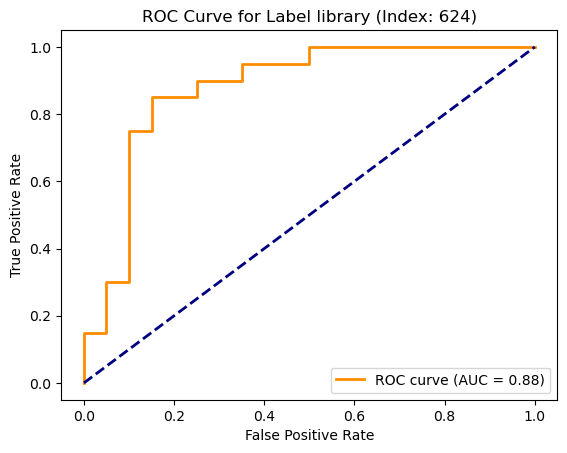

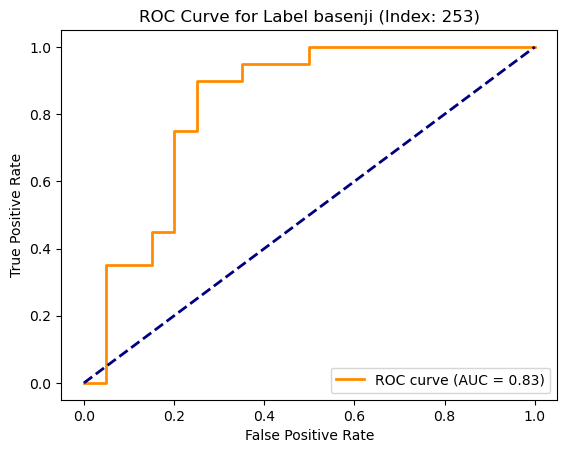

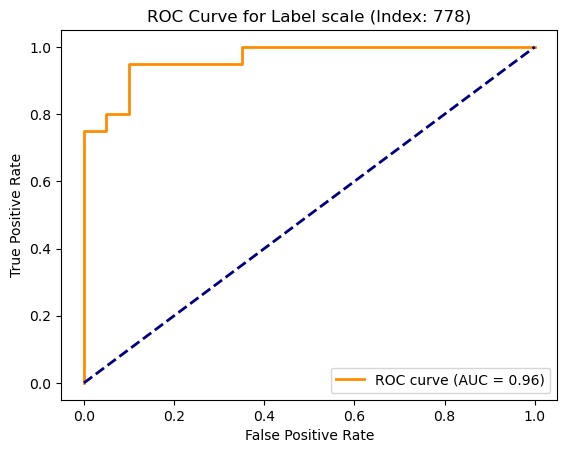

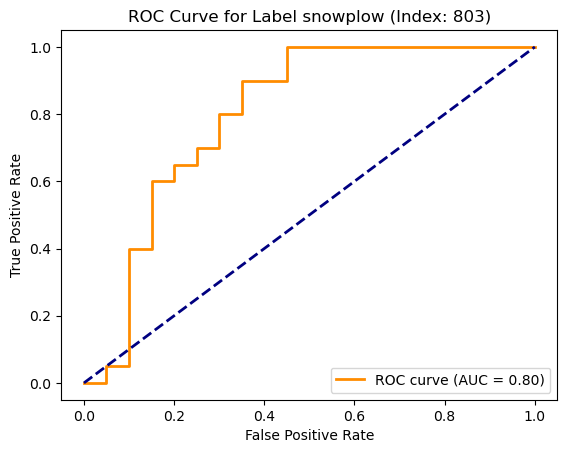

In [13]:
from sklearn.metrics import roc_curve, auc

def plot_roc_curve(all_logits_before, all_logits_after, target_labels):
    """
    Plot ROC curve for each target label to determine the optimal threshold.
    
    Args:
        all_logits_before (dict): Logit scores before watermarking for each label.
        all_logits_after (dict): Logit scores after watermarking for each label.
        target_labels (list): Indices of the target classes (secret labels).
    """
    for label in target_labels:
        # Combine logits before and after watermarking
        y_true = np.concatenate([np.zeros_like(all_logits_before[label]), np.ones_like(all_logits_after[label])])
        y_scores = np.concatenate([all_logits_before[label], all_logits_after[label]])

        # Compute ROC curve
        fpr, tpr, thresholds = roc_curve(y_true, y_scores)
        roc_auc = auc(fpr, tpr)

        # Plot ROC curve
        plt.figure()
        plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (AUC = {roc_auc:.2f})')
        plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title(f'ROC Curve for Label {IMAGENET_CLASSES[label]} (Index: {label})')
        plt.legend(loc="lower right")
        plt.show()

# Example usage
plot_roc_curve(all_secret_logits_before, all_secret_logits_after, secret_labels)

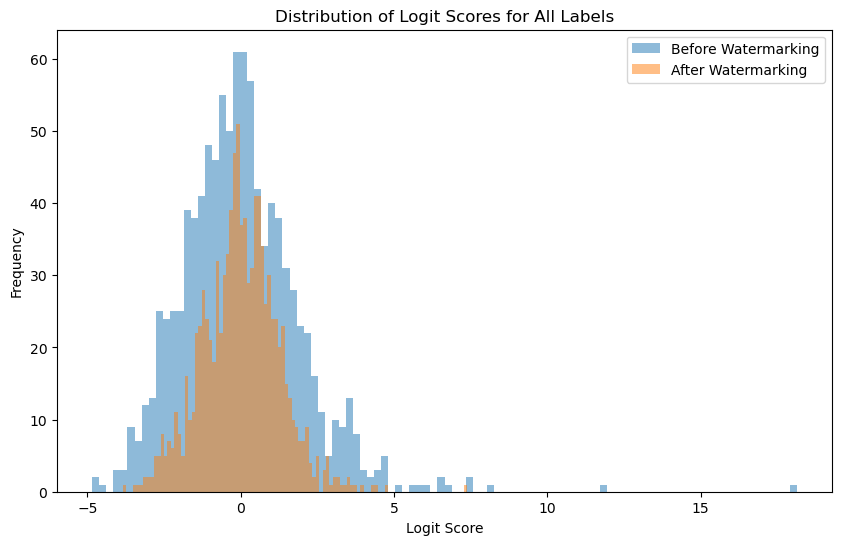

In [14]:

flattened_before = np.array(all_logits_before).flatten().tolist()
flattened_after = np.array(all_logits_after).flatten().tolist()

def plot_combined_histogram(all_logits_before, all_logits_after, bins=100):
    """
    Plot a combined histogram of logit scores for all labels before and after watermarking.
    
    Args:
        all_logits_before (list): Logit scores for all labels before watermarking.
        all_logits_after (list): Logit scores for all labels after watermarking.
        bins (int): Number of bins for the histogram.
    """
    plt.figure(figsize=(10, 6))
    plt.hist(all_logits_before, bins=bins, alpha=0.5, label="Before Watermarking")
    plt.hist(all_logits_after, bins=bins, alpha=0.5, label="After Watermarking")
    plt.legend()
    plt.xlabel("Logit Score")
    plt.ylabel("Frequency")
    plt.title("Distribution of Logit Scores for All Labels")
    plt.show()


plot_combined_histogram(flattened_before,flattened_after)